<a href="https://colab.research.google.com/github/santiagoviteri01/mmia_nlp_2023_2024/blob/main/model_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Model 1: LSTM and LP

In [1]:
pip install textdistance

In [2]:
pip install unidecode

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.5/235.5 kB 3.6 MB/s eta 0:00:00


In [3]:
pip install pytorch_lightning

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 890.6/890.6 kB 17.9 MB/s eta 0:00:00


## Data Processing

In [4]:
from google.colab import drive
import os
import pandas as pd
drive.mount('/content/drive')
import unicodedata
import string

Mounted at /content/drive


In [5]:
from unidecode import unidecode
import os
import pandas as pd
import unicodedata
import string
import re
from unidecode import unidecode
import textdistance


### Read and process the files:

In [8]:
all_letters = string.ascii_letters + " .,;'"
n_letters = len(all_letters)

def normalize_name(name):
    return unidecode(name).lower().strip()

def dataframes_from_csv(folder_path,code_1,code_2):
    # Read merged_gw.csv
    file = "merged_gw.csv"
    file_path = os.path.join(folder_path, file)
    df_1 = pd.read_csv(file_path, sep=",", encoding=code_1)
    df_1.info()

    # Read players_raw.csv
    file = "players_raw.csv"
    file_path = os.path.join(folder_path, file)
    df_2 = pd.read_csv(file_path, sep=",", encoding=code_2)
    df_2.info()

    # Clean and normalize names in df_1
    df_1['name'] = df_1['name'].astype(str).apply(unidecode)
    df_1['name'] = df_1['name'].apply(lambda x: re.sub(r'[_\d]+', ' ', x))
    #df_1['name'] = df_1['name'].apply(normalize_name)
    df_1['name'] = df_1['name'].replace('_', ' ')
    df_1['name'] = df_1['name'].apply(normalize_name)
    df_1['name'] = df_1['name'].str.strip().str.lower()

    # Clean and normalize names in df_2
    df_2['first_name'] = df_2['first_name'].str.strip().str.lower()
    df_2['second_name'] = df_2['second_name'].str.strip().str.lower()
    df_2['name'] = df_2['first_name'] + ' ' + df_2['second_name']
    df_2['name'] = df_2['name'].replace('_', ' ')
    df_2['name'] = df_2['name'].apply(normalize_name)
    df_2['name'] = df_2['name'].str.strip().str.lower()

    # Match names between df_1 and df_2
    #name_matches = match_names(df_1, df_2)

    # Merge df_1 with df_2 based on matched names
    df_1 = df_1.merge(df_2[["name",'team_code','element_type']], left_on='name', right_on='name')

    # Check for NaNs in merged dataframe
    missing_data = df_1[df_1.isnull().any(axis=1)]
    print("Names in df_2 not found in df_1:")
    missing_names = df_2[~df_2['name'].isin(df_1['name'])]['name']
    print(missing_names)
    return df_1


In [9]:
folder_path = "/content/drive/MyDrive/fpl/2016-2017"
code_1="latin-1"
code_2="utf-8"
df_1_2016_2017 = dataframes_from_csv(folder_path,code_1,code_2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23679 entries, 0 to 23678
Data columns (total 56 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   name                             23679 non-null  object 
 1   assists                          23679 non-null  int64  
 2   attempted_passes                 23679 non-null  int64  
 3   big_chances_created              23679 non-null  int64  
 4   big_chances_missed               23679 non-null  int64  
 5   bonus                            23679 non-null  int64  
 6   bps                              23679 non-null  int64  
 7   clean_sheets                     23679 non-null  int64  
 8   clearances_blocks_interceptions  23679 non-null  int64  
 9   completed_passes                 23679 non-null  int64  
 10  creativity                       23679 non-null  float64
 11  dribbles                         23679 non-null  int64  
 12  ea_index          

In [10]:
df_1_2016_2017.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23679 entries, 0 to 23678
Data columns (total 58 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   name                             23679 non-null  object 
 1   assists                          23679 non-null  int64  
 2   attempted_passes                 23679 non-null  int64  
 3   big_chances_created              23679 non-null  int64  
 4   big_chances_missed               23679 non-null  int64  
 5   bonus                            23679 non-null  int64  
 6   bps                              23679 non-null  int64  
 7   clean_sheets                     23679 non-null  int64  
 8   clearances_blocks_interceptions  23679 non-null  int64  
 9   completed_passes                 23679 non-null  int64  
 10  creativity                       23679 non-null  float64
 11  dribbles                         23679 non-null  int64  
 12  ea_index          

In [11]:
df_1_2016_2017.rename(columns={'team_code': 'team_y'}, inplace=True)

In [12]:
df_1_2016_2017.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23679 entries, 0 to 23678
Data columns (total 58 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   name                             23679 non-null  object 
 1   assists                          23679 non-null  int64  
 2   attempted_passes                 23679 non-null  int64  
 3   big_chances_created              23679 non-null  int64  
 4   big_chances_missed               23679 non-null  int64  
 5   bonus                            23679 non-null  int64  
 6   bps                              23679 non-null  int64  
 7   clean_sheets                     23679 non-null  int64  
 8   clearances_blocks_interceptions  23679 non-null  int64  
 9   completed_passes                 23679 non-null  int64  
 10  creativity                       23679 non-null  float64
 11  dribbles                         23679 non-null  int64  
 12  ea_index          

In [13]:
folder_path = "/content/drive/MyDrive/fpl/2017-2018"
code_1="latin-1"
code_2="utf-8"
df_1_2017_2018 = dataframes_from_csv(folder_path,code_1,code_2) #pierreemile hojbjerg

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22467 entries, 0 to 22466
Data columns (total 56 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   name                             22467 non-null  object 
 1   assists                          22467 non-null  int64  
 2   attempted_passes                 22467 non-null  int64  
 3   big_chances_created              22467 non-null  int64  
 4   big_chances_missed               22467 non-null  int64  
 5   bonus                            22467 non-null  int64  
 6   bps                              22467 non-null  int64  
 7   clean_sheets                     22467 non-null  int64  
 8   clearances_blocks_interceptions  22467 non-null  int64  
 9   completed_passes                 22467 non-null  int64  
 10  creativity                       22467 non-null  float64
 11  dribbles                         22467 non-null  int64  
 12  ea_index          

In [14]:
df_1_2017_2018.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22467 entries, 0 to 22466
Data columns (total 58 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   name                             22467 non-null  object 
 1   assists                          22467 non-null  int64  
 2   attempted_passes                 22467 non-null  int64  
 3   big_chances_created              22467 non-null  int64  
 4   big_chances_missed               22467 non-null  int64  
 5   bonus                            22467 non-null  int64  
 6   bps                              22467 non-null  int64  
 7   clean_sheets                     22467 non-null  int64  
 8   clearances_blocks_interceptions  22467 non-null  int64  
 9   completed_passes                 22467 non-null  int64  
 10  creativity                       22467 non-null  float64
 11  dribbles                         22467 non-null  int64  
 12  ea_index          

In [15]:
df_1_2017_2018.rename(columns={'team_code': 'team_y'}, inplace=True)

In [16]:
folder_path = "/content/drive/MyDrive/fpl/2018-2019"
code_1="latin-1"
code_2="utf-8"
df_1_2018_2019 = dataframes_from_csv(folder_path,code_1,code_2)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21790 entries, 0 to 21789
Data columns (total 56 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   name                             21790 non-null  object 
 1   assists                          21790 non-null  int64  
 2   attempted_passes                 21790 non-null  int64  
 3   big_chances_created              21790 non-null  int64  
 4   big_chances_missed               21790 non-null  int64  
 5   bonus                            21790 non-null  int64  
 6   bps                              21790 non-null  int64  
 7   clean_sheets                     21790 non-null  int64  
 8   clearances_blocks_interceptions  21790 non-null  int64  
 9   completed_passes                 21790 non-null  int64  
 10  creativity                       21790 non-null  float64
 11  dribbles                         21790 non-null  int64  
 12  ea_index          

In [17]:
df_1_2018_2019.rename(columns={'team_code': 'team_y'}, inplace=True)

In [18]:
folder_path = "/content/drive/MyDrive/fpl/2019-2020"
code_1="utf-8"
code_2="utf-8"
df_1_2019_2020 = dataframes_from_csv(folder_path,code_1,code_2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22560 entries, 0 to 22559
Data columns (total 33 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               22560 non-null  object 
 1   assists            22560 non-null  int64  
 2   bonus              22560 non-null  int64  
 3   bps                22560 non-null  int64  
 4   clean_sheets       22560 non-null  int64  
 5   creativity         22560 non-null  float64
 6   element            22560 non-null  int64  
 7   fixture            22560 non-null  int64  
 8   goals_conceded     22560 non-null  int64  
 9   goals_scored       22560 non-null  int64  
 10  ict_index          22560 non-null  float64
 11  influence          22560 non-null  float64
 12  kickoff_time       22560 non-null  object 
 13  minutes            22560 non-null  int64  
 14  opponent_team      22560 non-null  int64  
 15  own_goals          22560 non-null  int64  
 16  penalties_missed   225

In [19]:
df_1_2019_2020["GW"].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 39, 40, 41, 42, 43,
       44, 45, 46, 47])

In [20]:
def correct_gw_values(df):
    # Define a mapping for the incorrect gameweeks
    gw_mapping = {39: 30, 40: 31, 41: 32, 42: 33, 43: 34, 44: 35, 45: 36, 46: 37, 47: 38}

    # Apply the mapping to the GW column
    df['GW'] = df['GW'].replace(gw_mapping)

    # Check the unique values in the GW column after correction
    print("Corrected GW values:", df['GW'].unique())

    return df

In [21]:
# Example usage
# Assuming df_1_2019_2020 is your dataframe
df_1_2019_2020 = correct_gw_values(df_1_2019_2020)
df_1_2019_2020["GW"].unique()

Corrected GW values: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38]


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38])

In [22]:
df_1_2019_2020.rename(columns={'team_code': 'team_y'}, inplace=True)

In [23]:
folder_path = "/content/drive/MyDrive/fpl/2020-2021"
code_1="utf-8"
code_2="utf-8"
df_1_2020_2021 = dataframes_from_csv(folder_path,code_1,code_2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24365 entries, 0 to 24364
Data columns (total 36 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               24365 non-null  object 
 1   position           24365 non-null  object 
 2   team               24365 non-null  object 
 3   xP                 24365 non-null  float64
 4   assists            24365 non-null  int64  
 5   bonus              24365 non-null  int64  
 6   bps                24365 non-null  int64  
 7   clean_sheets       24365 non-null  int64  
 8   creativity         24365 non-null  float64
 9   element            24365 non-null  int64  
 10  fixture            24365 non-null  int64  
 11  goals_conceded     24365 non-null  int64  
 12  goals_scored       24365 non-null  int64  
 13  ict_index          24365 non-null  float64
 14  influence          24365 non-null  float64
 15  kickoff_time       24365 non-null  object 
 16  minutes            243

In [24]:
df_1_2020_2021.info()
df_1_2020_2021.rename(columns={'team_code': 'team_y'}, inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24420 entries, 0 to 24419
Data columns (total 38 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               24420 non-null  object 
 1   position           24420 non-null  object 
 2   team               24420 non-null  object 
 3   xP                 24420 non-null  float64
 4   assists            24420 non-null  int64  
 5   bonus              24420 non-null  int64  
 6   bps                24420 non-null  int64  
 7   clean_sheets       24420 non-null  int64  
 8   creativity         24420 non-null  float64
 9   element            24420 non-null  int64  
 10  fixture            24420 non-null  int64  
 11  goals_conceded     24420 non-null  int64  
 12  goals_scored       24420 non-null  int64  
 13  ict_index          24420 non-null  float64
 14  influence          24420 non-null  float64
 15  kickoff_time       24420 non-null  object 
 16  minutes            244

In [25]:
folder_path = "/content/drive/MyDrive/fpl/2021-2022"
code_1="utf-8"
code_2="utf-8"
df_1_2021_2022 = dataframes_from_csv(folder_path,code_1,code_2)
df_1_2021_2022.rename(columns={'team_code': 'team_y'}, inplace=True)
print(df_1_2021_2022[["team_y"]])

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25447 entries, 0 to 25446
Data columns (total 36 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               25447 non-null  object 
 1   position           25447 non-null  object 
 2   team               25447 non-null  object 
 3   xP                 25447 non-null  float64
 4   assists            25447 non-null  int64  
 5   bonus              25447 non-null  int64  
 6   bps                25447 non-null  int64  
 7   clean_sheets       25447 non-null  int64  
 8   creativity         25447 non-null  float64
 9   element            25447 non-null  int64  
 10  fixture            25447 non-null  int64  
 11  goals_conceded     25447 non-null  int64  
 12  goals_scored       25447 non-null  int64  
 13  ict_index          25447 non-null  float64
 14  influence          25447 non-null  float64
 15  kickoff_time       25447 non-null  object 
 16  minutes            254

In [26]:
folder_path = "/content/drive/MyDrive/fpl/2022-2023"
code_1="utf-8"
code_2="utf-8"
df_1_2022_2023 = dataframes_from_csv(folder_path,code_1,code_2)
df_1_2022_2023.rename(columns={'team_code': 'team_y'}, inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26505 entries, 0 to 26504
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   name                        26505 non-null  object 
 1   position                    26505 non-null  object 
 2   team                        26505 non-null  object 
 3   xP                          26505 non-null  float64
 4   assists                     26505 non-null  int64  
 5   bonus                       26505 non-null  int64  
 6   bps                         26505 non-null  int64  
 7   clean_sheets                26505 non-null  int64  
 8   creativity                  26505 non-null  float64
 9   element                     26505 non-null  int64  
 10  expected_assists            26505 non-null  float64
 11  expected_goal_involvements  26505 non-null  float64
 12  expected_goals              26505 non-null  float64
 13  expected_goals_conceded     265

In [27]:
folder_path = "/content/drive/MyDrive/fpl/2023-2024"
code_1="utf-8"
code_2="utf-8"
df_1_2023_2024 = dataframes_from_csv(folder_path,code_1,code_2)
df_1_2023_2024.rename(columns={'team_code': 'team_y'}, inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29725 entries, 0 to 29724
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   name                        29725 non-null  object 
 1   position                    29725 non-null  object 
 2   team                        29725 non-null  object 
 3   xP                          29725 non-null  float64
 4   assists                     29725 non-null  int64  
 5   bonus                       29725 non-null  int64  
 6   bps                         29725 non-null  int64  
 7   clean_sheets                29725 non-null  int64  
 8   creativity                  29725 non-null  float64
 9   element                     29725 non-null  int64  
 10  expected_assists            29725 non-null  float64
 11  expected_goal_involvements  29725 non-null  float64
 12  expected_goals              29725 non-null  float64
 13  expected_goals_conceded     297

In [28]:
folder_path = "/content/drive/MyDrive/fpl/2024-2025"
code_1="utf-8"
code_2="utf-8"
df_1_2024_2025 = dataframes_from_csv(folder_path,code_1,code_2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3211 entries, 0 to 3210
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   name                        3211 non-null   object 
 1   position                    3211 non-null   object 
 2   team                        3211 non-null   object 
 3   xP                          3211 non-null   float64
 4   assists                     3211 non-null   int64  
 5   bonus                       3211 non-null   int64  
 6   bps                         3211 non-null   int64  
 7   clean_sheets                3211 non-null   int64  
 8   creativity                  3211 non-null   float64
 9   element                     3211 non-null   int64  
 10  expected_assists            3211 non-null   float64
 11  expected_goal_involvements  3211 non-null   float64
 12  expected_goals              3211 non-null   float64
 13  expected_goals_conceded     3211 

In [29]:
df_1_2024_2025.rename(columns={'team_code': 'team_y'}, inplace=True)

Adjunt the gameweeks since for the 2020 season there were some gameweeks postponed due to covid

In [30]:
def adjust_gameweeks(df, start_gw):
    """
    Adjust the gameweeks of the DataFrame to start from start_gw.

    Parameters:
    df (pd.DataFrame): DataFrame containing the original data.
    start_gw (int): The starting gameweek number.

    Returns:
    pd.DataFrame: DataFrame with adjusted gameweeks.
    """
    df['GW'] = df['GW'] + start_gw
    return df

# Adjust the gameweeks for each season
df_1_2016_2017 = adjust_gameweeks(df_1_2016_2017, 0)
df_1_2017_2018 = adjust_gameweeks(df_1_2017_2018, 38)
df_1_2018_2019 = adjust_gameweeks(df_1_2018_2019, 76)
df_1_2019_2020 = adjust_gameweeks(df_1_2019_2020, 114)
df_1_2020_2021 = adjust_gameweeks(df_1_2020_2021, 152)
df_1_2021_2022 = adjust_gameweeks(df_1_2021_2022, 190)
df_1_2022_2023 = adjust_gameweeks(df_1_2022_2023, 228)
df_1_2023_2024 = adjust_gameweeks(df_1_2023_2024, 266)
df_1_2024_2025 = adjust_gameweeks(df_1_2024_2025, 304)


### Dataset for the first model:

In [32]:
df_1_2019_2020["year"]=2020 #add year column
df_1_2020_2021["year"]=2021 #add year column
df_1_2021_2022["year"]=2022 #add year column
df_1_2022_2023["year"]=2023 #add year column
df_1_2023_2024["year"]=2024 #add year column
df_1_2024_2025["year"]=2025 #add year column

df_1_2023_2024_m=df_1_2023_2024[df_1_2023_2024["GW"]<=(min(df_1_2023_2024["GW"]+3))]

df_combined = pd.concat([df_1_2016_2017, df_1_2017_2018, df_1_2018_2019, df_1_2019_2020, df_1_2020_2021, df_1_2021_2022, df_1_2022_2023], ignore_index=True)


In [33]:
df_1=df_combined

### Dictionaries

In [34]:
def categorize_player_points(df,variable):
    # Initialize dictionaries for each position
    goalkeepers = {}
    defenders = {}
    midfielders = {}
    forwards = {}

    # Determine the number of gameweeks (assuming the maximum gameweek number in your data)
    num_gameweeks = df['GW'].max()

    # Initialize each player's points list with zeros for all gameweeks
    for index, row in df.iterrows():
        player_name = row['name']
        element_type = row['element_type']

        if element_type == 1 and player_name not in goalkeepers:
            goalkeepers[player_name] = [0] * num_gameweeks
        elif element_type == 2 and player_name not in defenders:
            defenders[player_name] = [0] * num_gameweeks
        elif element_type == 3 and player_name not in midfielders:
            midfielders[player_name] = [0] * num_gameweeks
        elif element_type == 4 and player_name not in forwards:
            forwards[player_name] = [0] * num_gameweeks

    # Update the points list with actual values from the DataFrame
    for index, row in df.iterrows():
        player_name = row['name']
        points = row[variable]
        gameweek = row['GW'] - 1  # Subtract 1 to use as zero-based index
        element_type = row['element_type']

        if element_type == 1:
            goalkeepers[player_name][gameweek] = points
        elif element_type == 2:
            defenders[player_name][gameweek] = points
        elif element_type == 3:
            midfielders[player_name][gameweek] = points
        elif element_type == 4:
            forwards[player_name][gameweek] = points

    # Return dictionaries
    return goalkeepers, defenders, midfielders, forwards

def categorize_player_points_cost(df,variable):
    # Initialize dictionaries for each position
    goalkeepers = {}
    defenders = {}
    midfielders = {}
    forwards = {}

    # Determine the number of gameweeks (assuming the maximum gameweek number in your data)
    num_gameweeks = df['GW'].max()

    # Initialize each player's points list with zeros for all gameweeks
    for index, row in df.iterrows():
        player_name = row['name']
        element_type = row['element_type']

        if element_type == 1 and player_name not in goalkeepers:
            goalkeepers[player_name] = [40] * num_gameweeks
        elif element_type == 2 and player_name not in defenders:
            defenders[player_name] = [40] * num_gameweeks
        elif element_type == 3 and player_name not in midfielders:
            midfielders[player_name] = [40] * num_gameweeks
        elif element_type == 4 and player_name not in forwards:
            forwards[player_name] = [40] * num_gameweeks

    # Update the points list with actual values from the DataFrame
    for index, row in df.iterrows():
        player_name = row['name']
        points = row[variable]
        gameweek = row['GW'] - 1  # Subtract 1 to use as zero-based index
        element_type = row['element_type']

        if element_type == 1:
            goalkeepers[player_name][gameweek] = points
        elif element_type == 2:
            defenders[player_name][gameweek] = points
        elif element_type == 3:
            midfielders[player_name][gameweek] = points
        elif element_type == 4:
            forwards[player_name][gameweek] = points

    # Return dictionaries
    return goalkeepers, defenders, midfielders, forwards

goalkeepers, defenders, midfielders, forwards = categorize_player_points(df_1,"total_points")
goalkeepers_c, defenders_c, midfielders_c, forwards_c = categorize_player_points_cost(df_1,"value")

In [ ]:
print(df_1[(df_1["name"]=="jean-philippe mateta") & (df_1["GW"]==max(df_1["GW"]))]["value"])

### Quick EDA

In [ ]:
import matplotlib.pyplot as plt

avg_points_per_gw = df_1.groupby(['element_type'])['total_points'].mean()

# Plotting the average points per gameweek for each position
avg_points_per_gw.plot(kind='line', marker='o')
plt.xlabel("Gameweek") # Add a label for the x-axis
plt.ylabel("Average Points") # Add a label for the y-axis
plt.title("Average Points Distribution per Gameweek per Position") # Add a title to the plot
plt.legend(title='Position', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

,total_points
element_type,
1,1.055215
2,1.244168
3,1.367811
4,1.436948


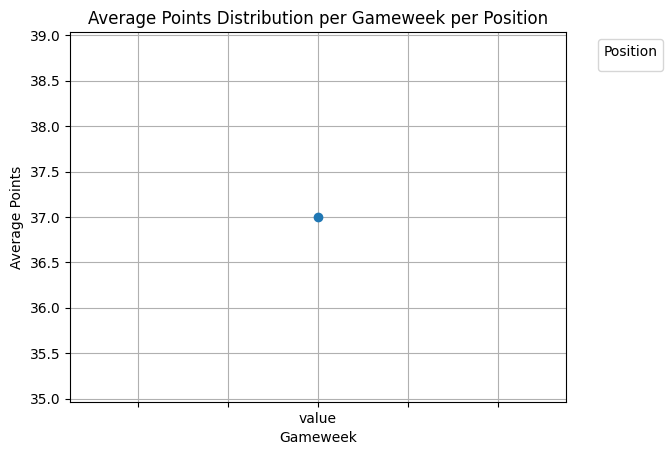

In [ ]:
avg_points_per_gw =(df_1[["value"]].min())
# Plotting the average points per gameweek for each position
avg_points_per_gw.plot(kind='line', marker='o')
plt.xlabel("Gameweek") # Add a label for the x-axis
plt.ylabel("Average Points") # Add a label for the y-axis
plt.title("Average Points Distribution per Gameweek per Position") # Add a title to the plot
plt.legend(title='Position', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

## Forecast

In [ ]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.nn.functional as F
import pytorch_lightning as pl

#### Dataset and Data Module

In [ ]:
class FantasyDataset(Dataset):
    def __init__(self, data, targets):
        self.data = torch.tensor(data, dtype=torch.float32)
        self.targets = torch.tensor(targets, dtype=torch.float32)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.targets[idx]

class FantasyDataModule(pl.LightningDataModule):
    def __init__(self, players_data, n_steps,batch_size=32):
        super().__init__()
        self.players_data = players_data
        self.n_steps = n_steps
        self.batch_size = batch_size


    def prepare_data(self):
        # Prepare dataset
        dataset = self.combine_player_data(self.players_data)
        self.X_train, self.X_val, self.X_test, self.y_train,self.y_val, self.y_test = self.prepare_dataset(dataset)

    def setup(self, stage=None):
        pass

    def train_dataloader(self):
        train_dataset = FantasyDataset(self.X_train, self.y_train)
        return DataLoader(train_dataset, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        val_dataset = FantasyDataset(self.X_val, self.y_val)
        return DataLoader(val_dataset, batch_size=self.batch_size)

    def test_dataloader(self):
        test_dataset = FantasyDataset(self.X_test, self.y_test)
        return DataLoader(test_dataset, batch_size=self.batch_size)

    def combine_player_data(self, players_data):
        max_points = max([len(points) for points in players_data.values()])
        num_players = len(players_data)
        combined_data = np.empty((max_points, num_players))
        combined_data[:] = 0

        for idx, (player, points) in enumerate(players_data.items()):
            combined_data[:len(points), idx] = points

        return combined_data


    def prepare_dataset(self, dataset):
        X, y = self.split_sequences(dataset, self.n_steps)
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1,random_state=None,shuffle=False)
        X_val, X_test, y_val, y_test= train_test_split(X_val, y_val, test_size=0.1, random_state=None,shuffle=False) ###change here
        return X_train, X_val, X_test, y_train, y_val, y_test

    def split_sequences(self, sequences, n_steps):
        X, y = [], []
        for i in range(len(sequences)):
            end_ix = i + n_steps
            if end_ix > len(sequences)-1:
                break
            seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix, :]
            X.append(seq_x)
            y.append(seq_y)
        return np.array(X), np.array(y)


In [ ]:
class FantasyLSTM(pl.LightningModule):
    def __init__(self, input_dim, hidden_dim, seq_length):
        super().__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.seq_length = seq_length

        self.lstm1 = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, input_dim)

    def predict(self, x):
        self.eval()  # Set model to evaluation mode
        with torch.no_grad():
            lstm_out, _ = self.lstm1(x)
            out = self.fc(lstm_out[:, -1, :])
        return out

    def forward(self, x):
        lstm_out, _ = self.lstm1(x)
        out = self.fc(lstm_out[:, -1, :])  # Take only the last time step's output
        return out

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=0.001)

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)

        # Log train loss
        self.log('train_loss', loss, on_step=True, on_epoch=True)

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)
        self.log('val_loss', loss, on_step=False, on_epoch=True)
        return loss

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)
        self.log('test_loss', loss)
        return loss


In [37]:
from pytorch_lightning.callbacks import ModelCheckpoint

#### Training and Evaluate

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import torch
import numpy as np
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping

def load_and_plot_metrics(log_dir,position):
    # Load metrics CSV

    metrics = pd.read_csv(f"{log_dir}/metrics.csv")

    # Aggregate metrics
    aggreg_metrics = []
    agg_col = "epoch"
    for i, dfg in metrics.groupby(agg_col):
        agg = dict(dfg.mean())
        agg[agg_col] = i
        aggreg_metrics.append(agg)

    df_metrics = pd.DataFrame(aggreg_metrics)

    # Print the available columns to verify their names
    #print(df_metrics)

    # Plotting the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(df_metrics['epoch'], df_metrics['train_loss_epoch'], label='Training Loss')
    plt.plot(df_metrics['epoch'], df_metrics['val_loss'], label='Validation Loss')
    plt.title(f'Training and Validation Loss for {position}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Function to create DataModule, train model, and evaluate
def train_and_evaluate(players_data, position,epocas):
    # Instantiate the LightningDataModule
    data_module = FantasyDataModule(players_data=players_data, n_steps=1) # n_steps changed to 4 since I want to predict the next 4 season outcomes
    # Ensure data preparation
    data_module.prepare_data()
    print(data_module.X_train.shape)
    print(data_module.X_val.shape)
    print(data_module.X_test.shape)

    # Instantiate the LightningModule
    model = FantasyLSTM(input_dim=data_module.X_train.shape[2], hidden_dim=100, seq_length=data_module.n_steps)

    # Define CSVLogger
    logger = pl.loggers.CSVLogger(save_dir="logs", name=f"{position}_exp_name")

    # Define checkpoint callback
    checkpoint_callback = ModelCheckpoint(
        monitor='val_loss',
        dirpath='checkpoints/{position}',
        filename='best_model-{epoch:02d}-{val_loss:.2f}',
        save_top_k=1,
        mode='min'
    )

    # Define early stopping callback
    early_stopping_callback = EarlyStopping(
        monitor='val_loss',
        patience=5,
        mode='min'
    )

    # Define the trainer
    trainer = pl.Trainer(
        max_epochs=epocas,
        logger=logger,
        callbacks=[checkpoint_callback,early_stopping_callback]
    )

    # Train the model
    trainer.fit(model, datamodule=data_module)
    # Load and plot metrics
    load_and_plot_metrics(trainer.logger.log_dir, position)

    # Load the best model from the checkpoint with the lowest validation loss
    best_model_path = checkpoint_callback.best_model_path
    best_model = FantasyLSTM.load_from_checkpoint(
        best_model_path,
        input_dim=data_module.X_train.shape[2],
        hidden_dim=100,
        seq_length=data_module.n_steps
    )

    # Put the model in evaluation mode
    best_model.eval()
    test_loader = data_module.test_dataloader()

    # Test the model on the test set
    test_results = trainer.test(model=best_model, dataloaders=test_loader)

    # Print test loss
    print(f"{position} Test Loss: {test_results[0]['test_loss']}")

    # Lists to store real values and predictions
    real_values = []
    predicted_values = []

    # Iterate over the test_loader to get predictions
    for batch in test_loader:
        x, y = batch
        y_hat_batch = best_model.predict(x)

        # Append real values and predictions
        real_values.extend(y.cpu().numpy())
        predicted_values.extend(y_hat_batch.cpu().numpy())

    # Convert lists to numpy arrays
    real_values = np.array(real_values).T
    predicted_values = np.array(predicted_values).T

    # Plotting
    plt.figure(figsize=(10, 6))
    player_names = list(players_data.keys())
    player_indices = np.arange(len(real_values))

    plt.scatter(player_indices, real_values[:,data_module.X_test.shape[0]-1], label='Real Values', marker='o', color='blue')
    plt.scatter(player_indices, predicted_values[:,data_module.X_test.shape[0]-1], label='Predicted Values', marker='x', color='red')
    plt.xlabel('Player Index')
    plt.ylabel('Value')
    plt.title(f'Comparison of Real and Predicted Values for {position}')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.xticks(rotation=45)
    plt.show()

    player_names = list(players_data.keys())

    df = pd.DataFrame({
        'Player Name': player_names,
        **{f'Real Value GW{gw}': real_values[:, gw - 1] for gw in range(1, real_values.shape[1] + 1)},
        **{f'Predicted Value GW{gw}': predicted_values[:, gw - 1] for gw in range(1, predicted_values.shape[1] + 1)}
    })
    return df



##### Total Points

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


(277, 1, 362)
(27, 1, 362)
(4, 1, 362)


INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 185 K  | train
1 | fc    | Linear | 36.6 K | train
-----------------------------------------
222 K     Trainable params
0         Non-trainable params
222 K     Total params
0.889     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

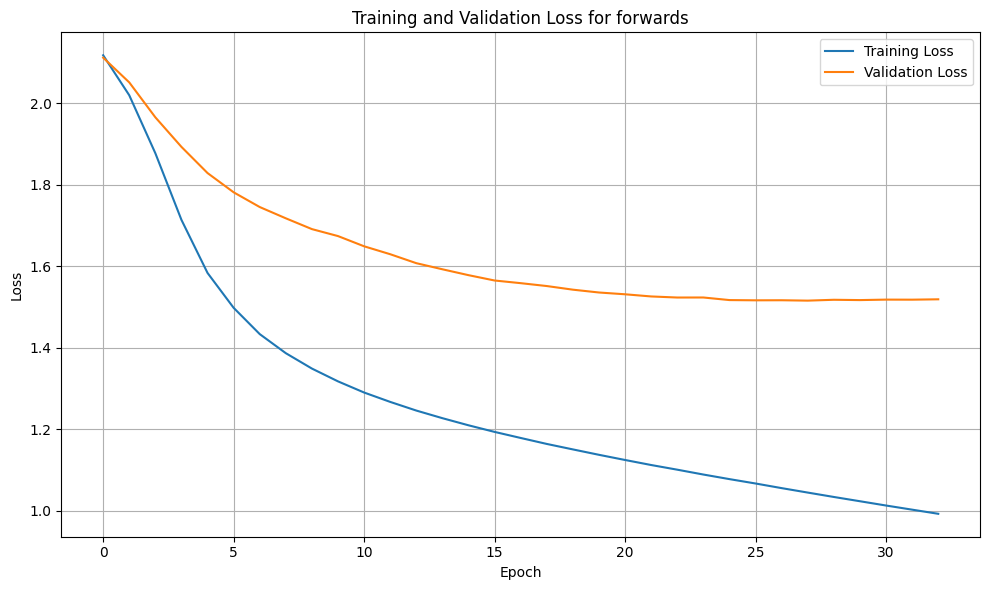

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    1.7533262968063354     │
└───────────────────────────┴───────────────────────────┘

forwards Test Loss: 1.7533262968063354


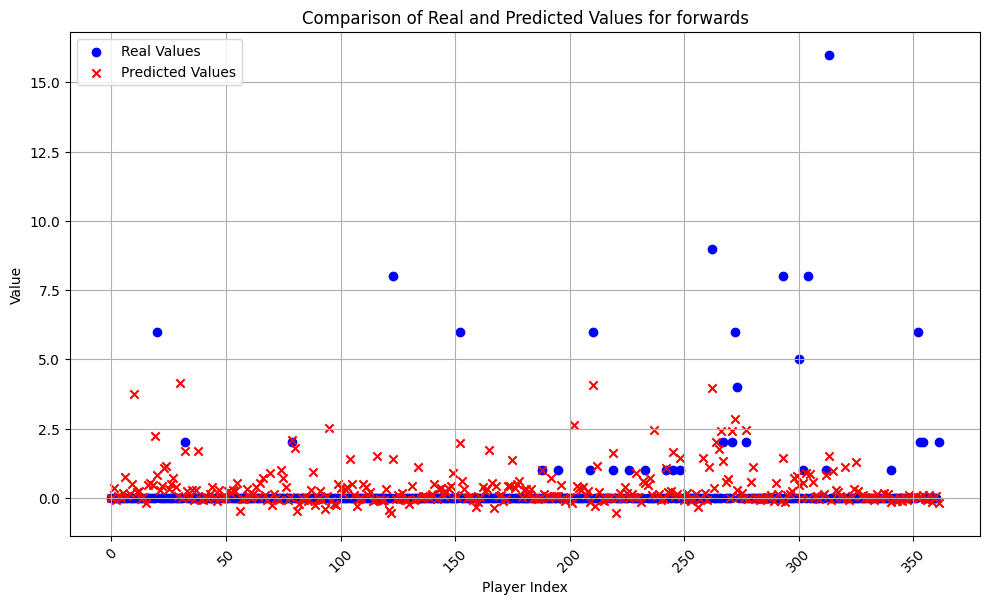

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/{position} exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 472 K  | train
1 | fc    | Linear | 109 K  | train
-----------------------------------------
581 K     Trainable params
0         Non-trainable params
581 K     Total params
2.328     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


(277, 1, 1080)
(27, 1, 1080)
(4, 1, 1080)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

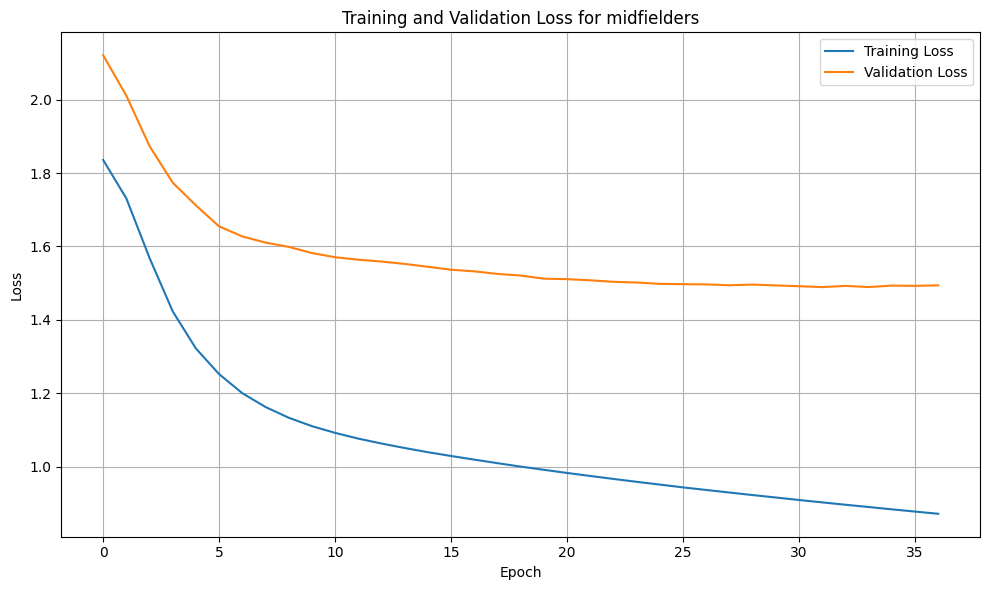

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     1.585010290145874     │
└───────────────────────────┴───────────────────────────┘

midfielders Test Loss: 1.585010290145874


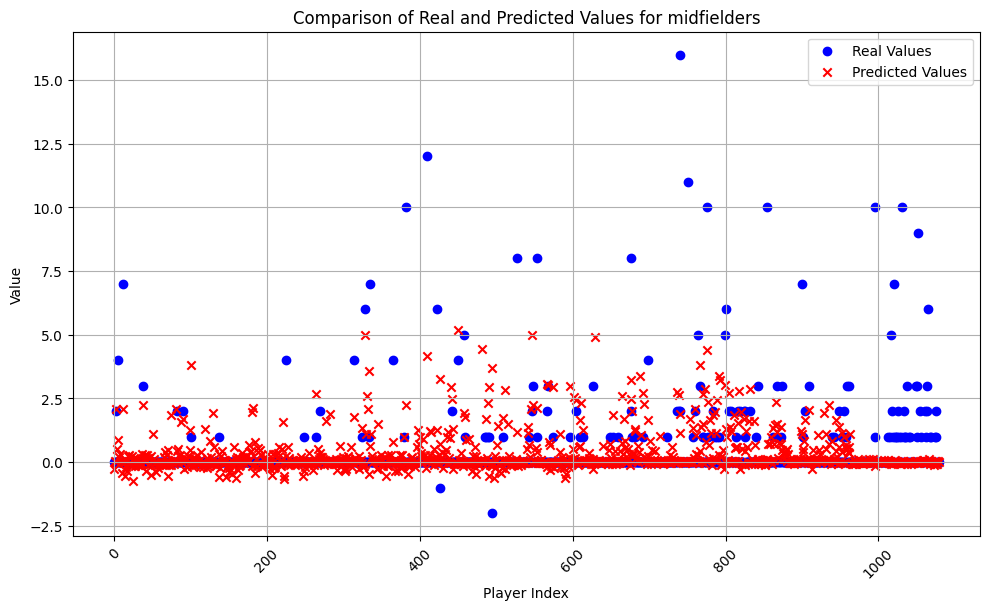

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/{position} exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 362 K  | train
1 | fc    | Linear | 81.3 K | train
-----------------------------------------
444 K     Trainable params
0         Non-trainable params
444 K     Total params
1.776     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


(277, 1, 805)
(27, 1, 805)
(4, 1, 805)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

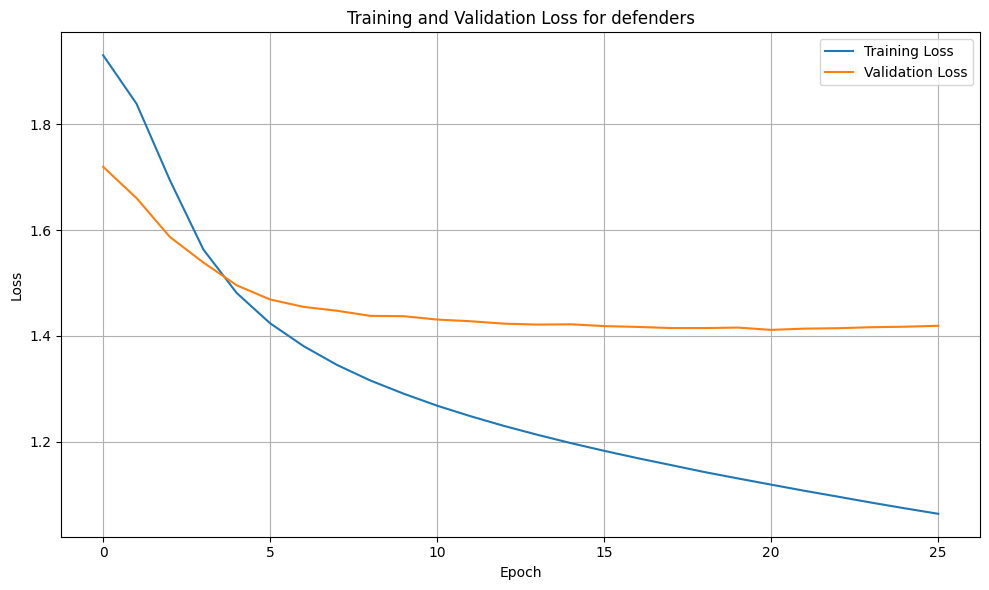

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    1.2077211141586304     │
└───────────────────────────┴───────────────────────────┘

defenders Test Loss: 1.2077211141586304


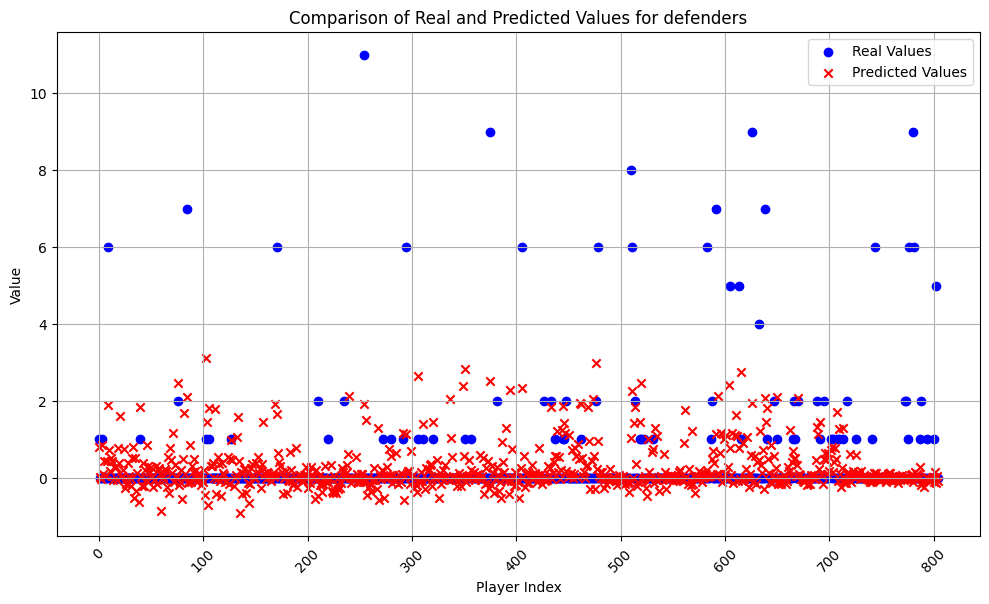

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/{position} exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 144 K  | train
1 | fc    | Linear | 26.2 K | train
-----------------------------------------
170 K     Trainable params
0         Non-trainable params
170 K     Total params
0.682     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


(277, 1, 259)
(27, 1, 259)
(4, 1, 259)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

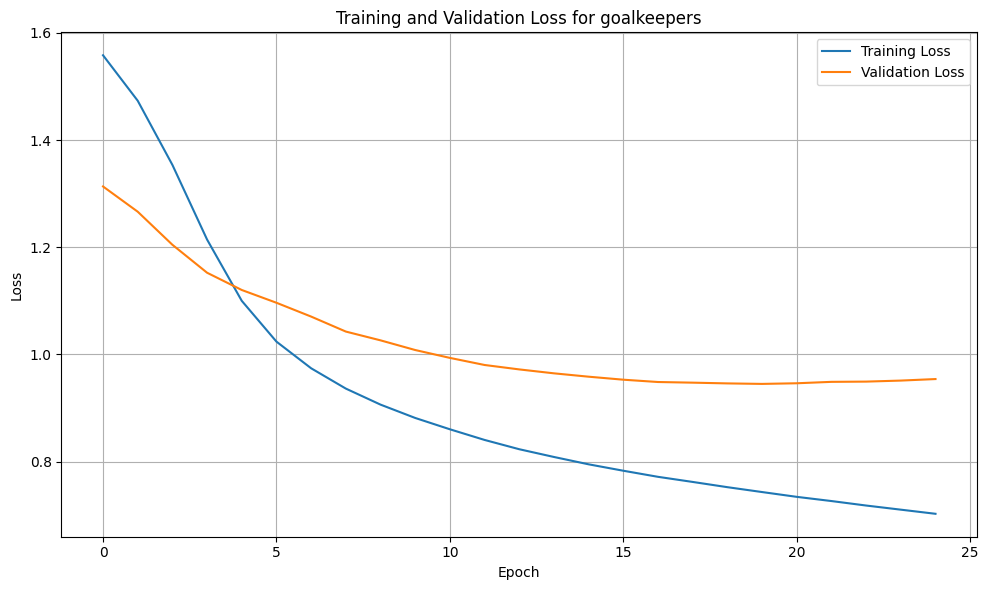

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    1.2294986248016357     │
└───────────────────────────┴───────────────────────────┘

goalkeepers Test Loss: 1.2294986248016357


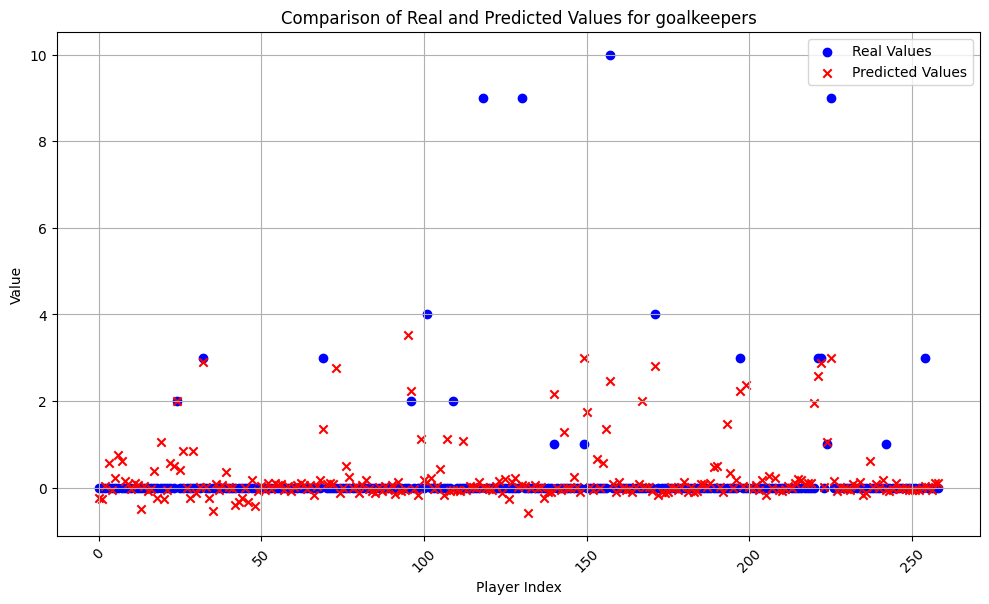

In [ ]:
# Train and evaluate for each position
f_pred_p=train_and_evaluate(forwards, 'forwards',500)
m_pred_p=train_and_evaluate(midfielders, 'midfielders',500)
d_pred_p=train_and_evaluate(defenders, 'defenders',500)
g_pred_p=train_and_evaluate(goalkeepers, 'goalkeepers',500)

##### Total Cost

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/{position} exists and is not empty.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 185 K  | train
1 | fc    | Linear | 36.6 K | train
-----------------------------------------
222 K     Trainable params
0         Non-trainable params
222 K     Total params
0.889     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


(277, 1, 362)
(27, 1, 362)
(4, 1, 362)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

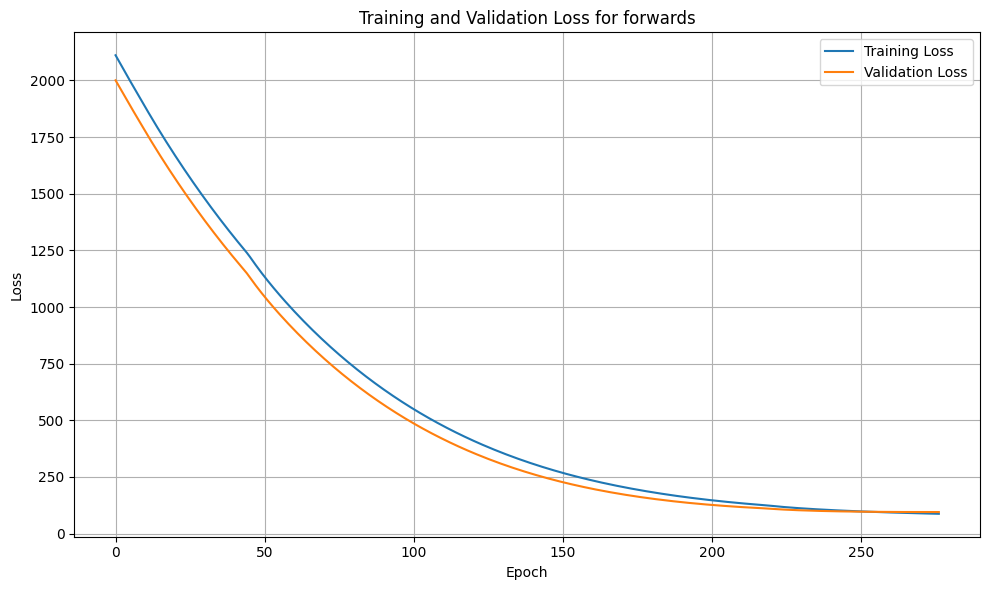

In [ ]:
# Train and evaluate for each position
f_pred_c=train_and_evaluate(forwards_c, 'forwards', 800)
m_pred_c=train_and_evaluate(midfielders_c, 'midfielders',800)
d_pred_c=train_and_evaluate(defenders_c, 'defenders',800)
g_pred_c=train_and_evaluate(goalkeepers_c, 'goalkeepers', 800)

#### Re-Training and Predicting

In [39]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.nn.functional as F
import pytorch_lightning as pl
import pandas as pd
import matplotlib.pyplot as plt
import torch
import numpy as np
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping

class FantasyDataset(Dataset):
    def __init__(self, data, targets):
        self.data = torch.tensor(data, dtype=torch.float32)
        self.targets = torch.tensor(targets, dtype=torch.float32)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.targets[idx]

class FantasyDataModule(pl.LightningDataModule):
    def __init__(self, players_data, n_steps,batch_size=32):
        super().__init__()
        self.players_data = players_data
        self.n_steps = n_steps
        self.batch_size = batch_size


    def prepare_data(self):
        # Prepare dataset
        dataset = self.combine_player_data(self.players_data)
        self.X_train, self.X_val, self.X_test, self.y_train,self.y_val, self.y_test = self.prepare_dataset(dataset)

    def setup(self, stage=None):
        pass

    def train_dataloader(self):
        train_dataset = FantasyDataset(self.X_train, self.y_train)
        return DataLoader(train_dataset, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        val_dataset = FantasyDataset(self.X_val, self.y_val)
        return DataLoader(val_dataset, batch_size=self.batch_size)

    def test_dataloader(self):
        test_dataset = FantasyDataset(self.X_test, self.y_test)
        return DataLoader(test_dataset, batch_size=self.batch_size)

    def combine_player_data(self, players_data):
        max_points = max([len(points) for points in players_data.values()])
        num_players = len(players_data)
        combined_data = np.empty((max_points, num_players))
        combined_data[:] = 0

        for idx, (player, points) in enumerate(players_data.items()):
            combined_data[:len(points), idx] = points

        return combined_data


    def prepare_dataset(self, dataset):
        X, y = self.split_sequences(dataset, self.n_steps)
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1,random_state=None,shuffle=False)
        X_val, X_test, y_val, y_test= train_test_split(X_val, y_val, test_size=0.1, random_state=None,shuffle=False) ###change here
        return X_train, X_val, X_test, y_train, y_val, y_test

    def split_sequences(self, sequences, n_steps):
        X, y = [], []
        for i in range(len(sequences)):
            end_ix = i + n_steps
            if end_ix > len(sequences)-1:
                break
            seq_x, seq_y = sequences[i:end_ix, :], sequences[end_ix, :]
            X.append(seq_x)
            y.append(seq_y)
        return np.array(X), np.array(y)

def load_and_plot_metrics(log_dir,position):
    # Load metrics CSV

    metrics = pd.read_csv(f"{log_dir}/metrics.csv")

    # Aggregate metrics
    aggreg_metrics = []
    agg_col = "epoch"
    for i, dfg in metrics.groupby(agg_col):
        agg = dict(dfg.mean())
        agg[agg_col] = i
        aggreg_metrics.append(agg)

    df_metrics = pd.DataFrame(aggreg_metrics)

    # Print the available columns to verify their names
    #print(df_metrics)

    # Plotting the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(df_metrics['epoch'], df_metrics['train_loss_epoch'], label='Training Loss')
    plt.plot(df_metrics['epoch'], df_metrics['val_loss'], label='Validation Loss')
    plt.title(f'Training and Validation Loss for {position}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Function to create DataModule, train model, and evaluate
def train_and_evaluate(players_data, position,epocas):
    # Instantiate the LightningDataModule
    data_module = FantasyDataModule(players_data=players_data, n_steps=1)
    # Ensure data preparation
    data_module.prepare_data()
    print(data_module.X_train.shape)
    print(data_module.X_val.shape)
    print(data_module.X_test.shape)

    # Instantiate the LightningModule
    model = FantasyLSTM(input_dim=data_module.X_train.shape[2], hidden_dim=100, seq_length=data_module.n_steps)

    # Define CSVLogger
    logger = pl.loggers.CSVLogger(save_dir="logs", name=f"{position}_exp_name")

    # Define checkpoint callback
    checkpoint_callback = ModelCheckpoint(
        monitor='val_loss',
        dirpath='checkpoints/{position}',
        filename='best_model-{epoch:02d}-{val_loss:.2f}',
        save_top_k=1,
        mode='min'
    )

    # Define early stopping callback
    early_stopping_callback = EarlyStopping(
        monitor='val_loss',
        patience=5,
        mode='min'
    )

    # Define the trainer
    trainer = pl.Trainer(
        max_epochs=epocas,
        logger=logger,
        callbacks=[checkpoint_callback,early_stopping_callback]
    )

    # Train the model
    trainer.fit(model, datamodule=data_module)
    # Load and plot metrics
    load_and_plot_metrics(trainer.logger.log_dir, position)

    # Load the best model from the checkpoint with the lowest validation loss
    best_model_path = checkpoint_callback.best_model_path
    best_model = FantasyLSTM.load_from_checkpoint(
        best_model_path,
        input_dim=data_module.X_train.shape[2],
        hidden_dim=100,
        seq_length=data_module.n_steps
    )

    # Put the model in evaluation mode
    best_model.eval()
    test_loader = data_module.test_dataloader()

    # Test the model on the test set
    test_results = trainer.test(model=best_model, dataloaders=test_loader)

    # Print test loss
    print(f"{position} Test Loss: {test_results[0]['test_loss']}")

    # Lists to store real values and predictions
    real_values = []
    predicted_values = []

    # Iterate over the test_loader to get predictions
    for batch in test_loader:
        x, y = batch
        y_hat_batch = best_model.predict(x)

        # Append real values and predictions
        real_values.extend(y.cpu().numpy())
        predicted_values.extend(y_hat_batch.cpu().numpy())

    # Convert lists to numpy arrays
    real_values = np.array(real_values).T
    predicted_values = np.array(predicted_values).T

    # Plotting
    plt.figure(figsize=(10, 6))
    player_names = list(players_data.keys())
    player_indices = np.arange(len(real_values))

    plt.scatter(player_indices, real_values[:, 3], label='Real Values', marker='o', color='blue')
    plt.scatter(player_indices, predicted_values[:, 3], label='Predicted Values', marker='x', color='red')
    plt.xlabel('Player Index')
    plt.ylabel('Value')
    plt.title(f'Comparison of Real and Predicted Values for {position}')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.xticks(rotation=45)
    plt.show()

    player_names = list(players_data.keys())

    df = pd.DataFrame({
        'Player Name': player_names,
        **{f'Real Value GW{gw}': real_values[:, gw - 1] for gw in range(1, real_values.shape[1] + 1)},
        **{f'Predicted Value GW{gw}': predicted_values[:, gw - 1] for gw in range(1, predicted_values.shape[1] + 1)}
    })
    return df

In [40]:
import pandas as pd
import matplotlib.pyplot as plt
import torch
import numpy as np
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import torch.nn as nn
import torch.nn.functional as F

# Dataset Definition
class FantasyPredictionDataset(Dataset):
    def __init__(self, data, targets):
        self.data = torch.tensor(data, dtype=torch.float32)
        self.targets = torch.tensor(targets, dtype=torch.float32)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.targets[idx]

# DataModule Definition
class FantasyPredictionDataModule(pl.LightningDataModule):
    def __init__(self, players_data, n_steps, batch_size=32):
        super().__init__()
        self.players_data = players_data
        self.n_steps = n_steps
        self.batch_size = batch_size

    def prepare_data(self):
        # Prepare dataset
        dataset = self.combine_player_data(self.players_data)
        self.X_train, self.X_val, _, self.y_train, self.y_val, _ = self.prepare_dataset(dataset)

    def setup(self, stage=None):
        pass

    def train_dataloader(self):
        train_dataset = FantasyDataset(self.X_train, self.y_train)
        return DataLoader(train_dataset, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        val_dataset = FantasyDataset(self.X_val, self.y_val)
        return DataLoader(val_dataset, batch_size=self.batch_size)

    def test_dataloader(self):
        if self.X_test is not None and self.y_test is not None:
            test_dataset = FantasyDataset(self.X_test, self.y_test)
            return DataLoader(test_dataset, batch_size=self.batch_size)
        else:
            return None

    def combine_player_data(self, players_data):
        max_points = max([len(points) for points in players_data.values()])
        num_players = len(players_data)
        combined_data = np.empty((max_points, num_players))
        combined_data[:] = 0

        for idx, (player, points) in enumerate(players_data.items()):
            combined_data[:len(points), idx] = points

        return combined_data

    def prepare_dataset(self, dataset):
        X, y = self.split_sequences(dataset, self.n_steps)
        # Mantener el 10% para validación
        X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.01, random_state=None, shuffle=False)
        # No crear conjunto de prueba
        return X_train, X_val, None, y_train, y_val, None

    def split_sequences(self, sequences, n_steps):
        X, y = [], []
        for i in range(len(sequences) - n_steps):
            seq_x = sequences[i:i+n_steps, :]
            seq_y = sequences[i+n_steps, :]
            X.append(seq_x)
            y.append(seq_y)
        return np.array(X), np.array(y)

# Model Definition
class FantasyPredictionLSTM(pl.LightningModule):
    def __init__(self, input_dim, hidden_dim, seq_length):
        super().__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.seq_length = seq_length

        self.lstm1 = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, input_dim)

    def predict(self, x):
        self.eval()  # Set model to evaluation mode
        with torch.no_grad():
            lstm_out, _ = self.lstm1(x)
            out = self.fc(lstm_out[:, -1, :])
        return out

    def forward(self, x):
        lstm_out, _ = self.lstm1(x)
        out = self.fc(lstm_out[:, -1, :])  # Take only the last time step's output
        return out

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=0.001)

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)

        # Log train loss
        self.log('train_loss', loss, on_step=True, on_epoch=True)

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)
        self.log('val_loss', loss, on_step=False, on_epoch=True)
        return loss

    def test_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = F.mse_loss(y_hat, y)
        self.log('test_loss', loss)
        return loss

# Función para Cargar y Graficar Métricas
def load_and_plot_metrics(log_dir, position):
    # Load metrics CSV
    metrics = pd.read_csv(f"{log_dir}/metrics.csv")

    # Aggregate metrics
    aggreg_metrics = []
    agg_col = "epoch"
    for i, dfg in metrics.groupby(agg_col):
        agg = dict(dfg.mean())
        agg[agg_col] = i
        aggreg_metrics.append(agg)

    df_metrics = pd.DataFrame(aggreg_metrics)

    # Plotting the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(df_metrics['epoch'], df_metrics['train_loss_epoch'], label='Training Loss')
    plt.plot(df_metrics['epoch'], df_metrics['val_loss'], label='Validation Loss')
    plt.title(f'Training and Validation Loss for {position}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Función de Predicción Iterativa
def forecast_future(model, data, n_steps, n_forecast):
    model.eval()
    forecast = []
    current_seq = data[-n_steps:].copy()
    device = next(model.parameters()).device


    for _ in range(n_forecast):
        x = torch.tensor(current_seq, dtype=torch.float32).unsqueeze(0).to(device)  # Añadir dimensión de batch
        with torch.no_grad():
            y_hat = model.predict(x).cpu().numpy().flatten()
        forecast.append(y_hat)
        current_seq = np.vstack([current_seq[1:], y_hat])

    return np.array(forecast)

# Función para Entrenar y Evaluar
def train_and_predict(players_data, position, epocas):
    # Instantiate the LightningDataModule
    data_module = FantasyPredictionDataModule(players_data=players_data, n_steps=1)
    # Ensure data preparation
    data_module.prepare_data()
    print(f"Train Data Shape: {data_module.X_train.shape}")
    print(f"Validation Data Shape: {data_module.X_val.shape}")

    # Instantiate the LightningModule
    model = FantasyPredictionLSTM(input_dim=data_module.X_train.shape[2], hidden_dim=100, seq_length=data_module.n_steps)

    # Define CSVLogger
    logger = pl.loggers.CSVLogger(save_dir="logs", name=f"{position}_exp_name_prediction")

    # Define checkpoint callback
    checkpoint_callback = ModelCheckpoint(
        monitor='val_loss',
        dirpath=f'checkpoints/{position}',
        filename='best_model-{epoch:02d}-{val_loss:.2f}',
        save_top_k=1,
        mode='min'
    )

    # Define early stopping callback
    early_stopping_callback = EarlyStopping(
        monitor='val_loss',
        patience=5,
        mode='min'
    )

    # Define the trainer
    trainer = pl.Trainer(
        max_epochs=epocas,
        logger=logger,
        callbacks=[checkpoint_callback, early_stopping_callback]
    )

    # Train the model
    trainer.fit(model, datamodule=data_module)

    # Cargar y graficar métricas
    load_and_plot_metrics(trainer.logger.log_dir, position)

    # Cargar el mejor modelo desde el checkpoint con la menor pérdida de validación
    best_model_path = checkpoint_callback.best_model_path
    best_model = FantasyPredictionLSTM.load_from_checkpoint(
        best_model_path,
        input_dim=data_module.X_train.shape[2],
        hidden_dim=100,
        seq_length=data_module.n_steps
    )

    # Obtener los datos combinados
    combined_data = data_module.combine_player_data(players_data)

    # Realizar predicción para las próximas 4 semanas
    forecast = forecast_future(best_model, combined_data, data_module.n_steps, n_forecast=4)

    # Convertir la predicción a DataFrame
    player_names = list(players_data.keys())
    forecast_df = pd.DataFrame(forecast.T, columns=[f'GW{gw}' for gw in range(1, 5)])
    forecast_df.insert(0, 'Player Name', player_names)
    print(forecast_df.head())

    return forecast_df


Treining total points

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Train Data Shape: (262, 1, 302)
Validation Data Shape: (3, 1, 302)


INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 161 K  | train
1 | fc    | Linear | 30.5 K | train
-----------------------------------------
192 K     Trainable params
0         Non-trainable params
192 K     Total params
0.768     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

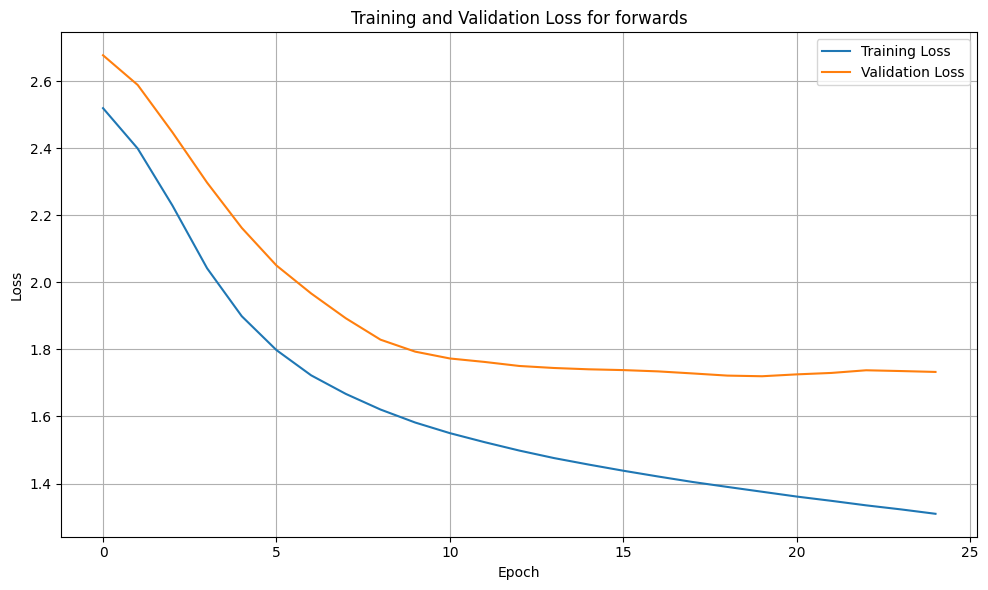

      Player Name       GW1       GW2       GW3       GW4
0  abel hernandez -0.019673  0.205800  0.237973  0.245391
1  adama diomande  0.009299  0.125131  0.118229  0.122057
2      ahmed musa -0.042731  0.142119  0.139163  0.145983
3      andre gray  0.234948  0.029745  0.011499  0.012701
4    andy carroll  0.207998  0.136022  0.188430  0.195884
Train Data Shape: (262, 1, 897)
Validation Data Shape: (3, 1, 897)


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 399 K  | train
1 | fc    | Linear | 90.6 K | train
-----------------------------------------
490 K     Trainable params
0         Non-trainable params
490 K     Total params
1.961     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

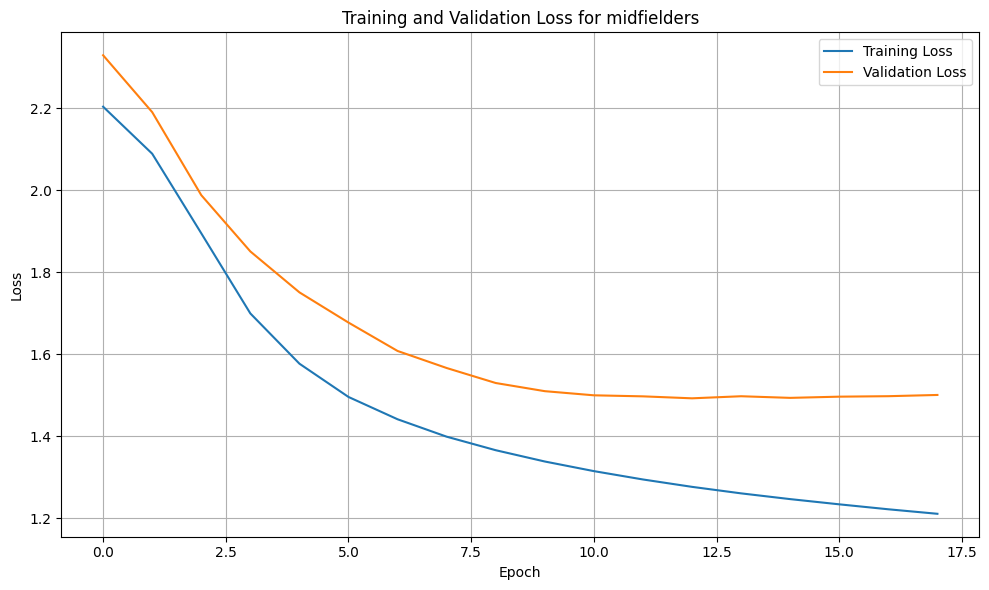

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 313 K  | train
1 | fc    | Linear | 68.9 K | train
-----------------------------------------
382 K     Trainable params
0         Non-trainable params
382 K     Total params
1.530     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


          Player Name       GW1       GW2       GW3       GW4
0        aaron lennon  0.115553  0.264150  0.265367  0.267764
1        aaron ramsey  0.073168  0.111565  0.130915  0.135203
2  abdoulaye doucoure  1.763123  1.628171  1.629023  1.627927
3        adam clayton -0.072935  0.250363  0.248847  0.253012
4        adam forshaw  0.404293  0.490650  0.512246  0.517201
Train Data Shape: (262, 1, 682)
Validation Data Shape: (3, 1, 682)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

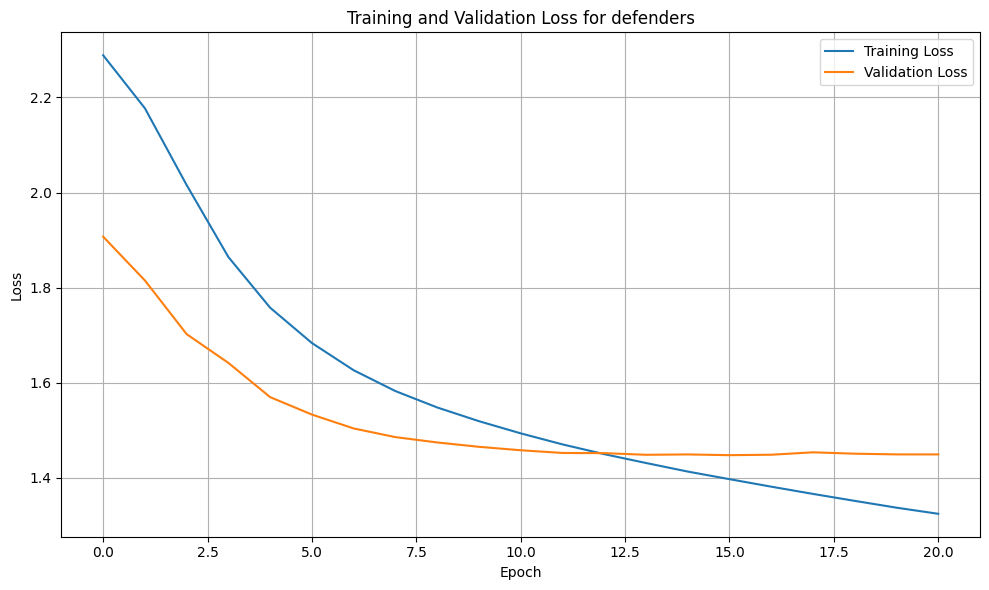

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 126 K  | train
1 | fc    | Linear | 21.7 K | train
-----------------------------------------
148 K     Trainable params
0         Non-trainable params
148 K     Total params
0.594     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


         Player Name       GW1       GW2       GW3       GW4
0    aaron cresswell  1.984606  2.335562  2.576791  2.725083
1  abdul rahman baba  0.088329  0.031365  0.018382  0.000424
2      adam matthews  0.078066 -0.032317 -0.043032 -0.057735
3         adam smith  1.370604  1.656360  1.657013  1.627811
4     alberto moreno -0.097733 -0.063673 -0.027130 -0.007600
Train Data Shape: (262, 1, 215)
Validation Data Shape: (3, 1, 215)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

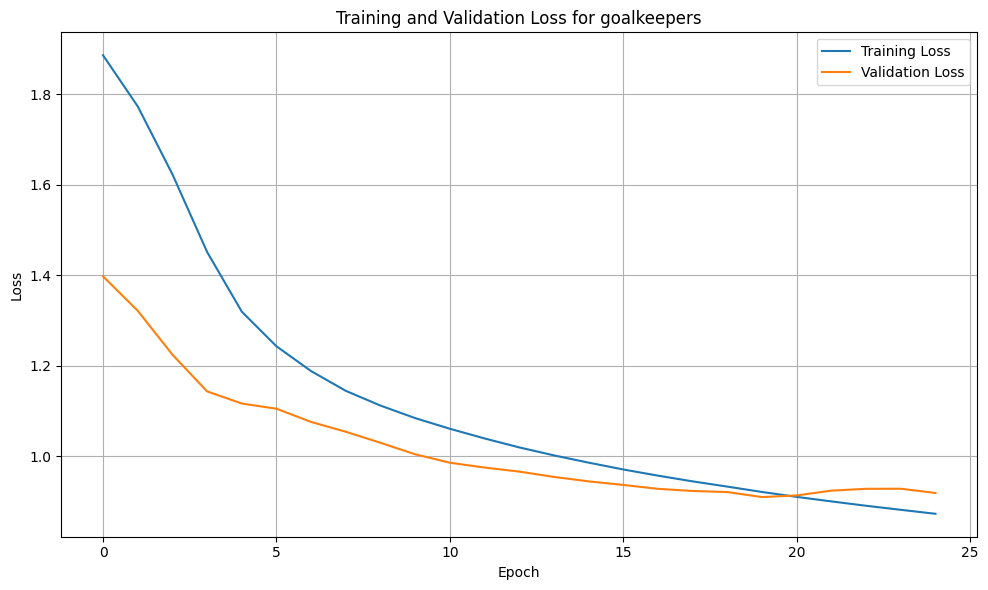

                      Player Name       GW1       GW2       GW3       GW4
0                   adam federici -0.109345  0.008716  0.040636  0.053943
1  adrian san miguel del castillo -0.018085  0.111453  0.135187  0.154027
2             alexander manninger -0.042713 -0.032518 -0.015709 -0.007620
3                   alex mccarthy  0.606300  0.543154  0.433017  0.391417
4                  allan mcgregor  0.071279 -0.012080 -0.023563 -0.030075


In [41]:
f_pred_pf=train_and_predict(forwards, 'forwards', 100)
m_pred_pf=train_and_predict(midfielders, 'midfielders', 100)
d_pred_pf=train_and_predict(defenders, 'defenders', 100)
g_pred_pf=train_and_predict(goalkeepers, 'goalkeepers', 100)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/forwards exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 161 K  | train
1 | fc    | Linear | 30.5 K | train
-----------------------------------------
192 K     Trainable params
0         Non-trainable params
192 K     Total params
0.768     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


Train Data Shape: (262, 1, 302)
Validation Data Shape: (3, 1, 302)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

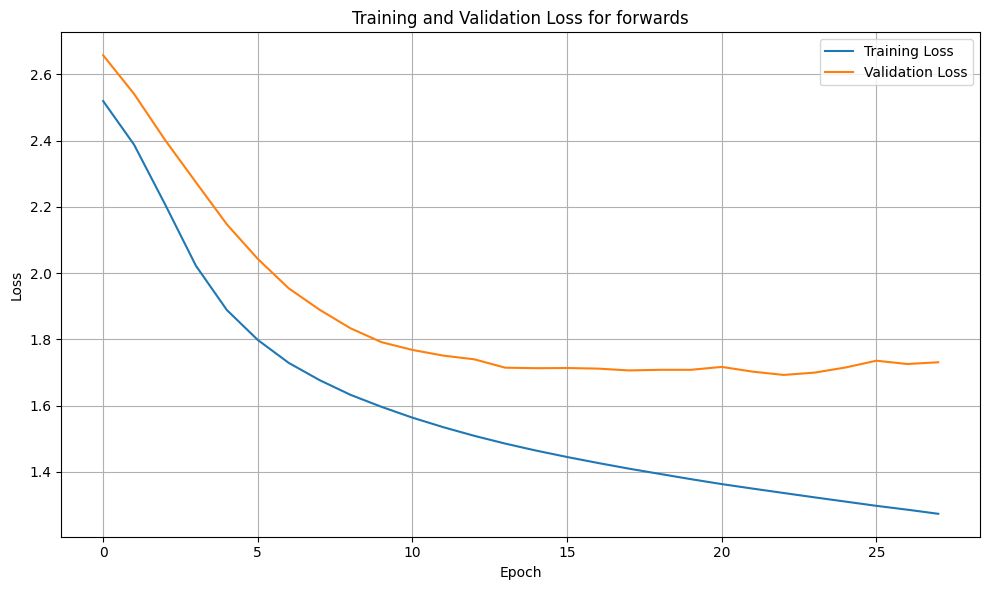

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 399 K  | train
1 | fc    | Linear | 90.6 K | train
-----------------------------------------
490 K     Trainable params
0         Non-trainable params
490 K     Total params
1.961     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


      Player Name       GW1       GW2       GW3       GW4
0  abel hernandez -0.050369 -0.128799 -0.135427 -0.139998
1  adama diomande -0.131380 -0.120777 -0.089548 -0.084015
2      ahmed musa -0.000527 -0.043726 -0.063235 -0.069028
3      andre gray -0.096305 -0.148654 -0.097889 -0.082334
4    andy carroll  0.113820  0.021391  0.011773  0.006642
Train Data Shape: (262, 1, 897)
Validation Data Shape: (3, 1, 897)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

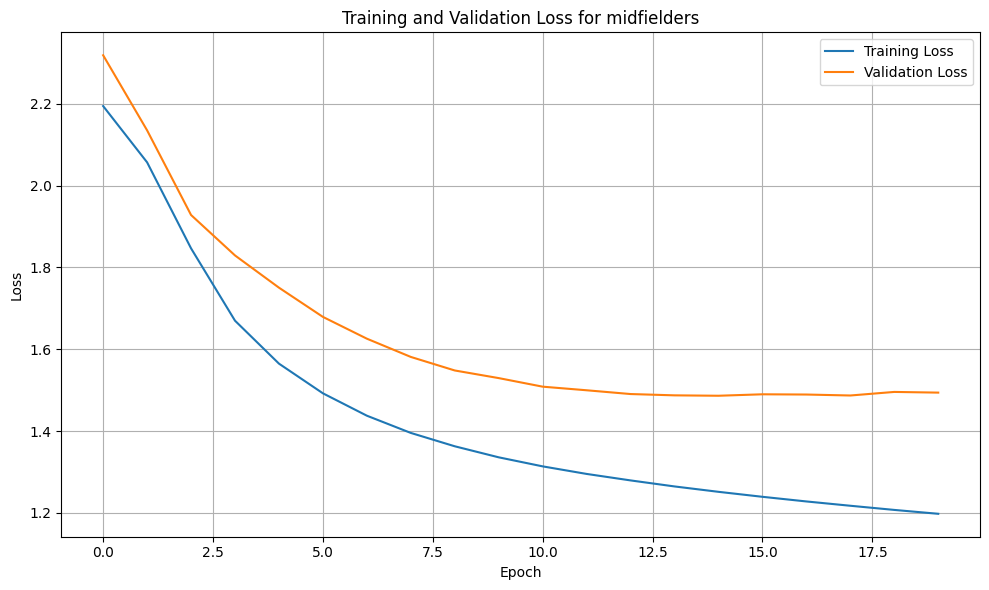

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 313 K  | train
1 | fc    | Linear | 68.9 K | train
-----------------------------------------
382 K     Trainable params
0         Non-trainable params
382 K     Total params
1.530     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


          Player Name       GW1       GW2       GW3       GW4
0        aaron lennon  0.569822  0.261900  0.245256  0.226701
1        aaron ramsey -0.055979  0.112957  0.121421  0.140816
2  abdoulaye doucoure  1.870696  1.908351  1.900888  1.909317
3        adam clayton -0.176357 -0.198098 -0.186026 -0.177365
4        adam forshaw  0.256055  0.290176  0.304457  0.309891
Train Data Shape: (262, 1, 682)
Validation Data Shape: (3, 1, 682)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

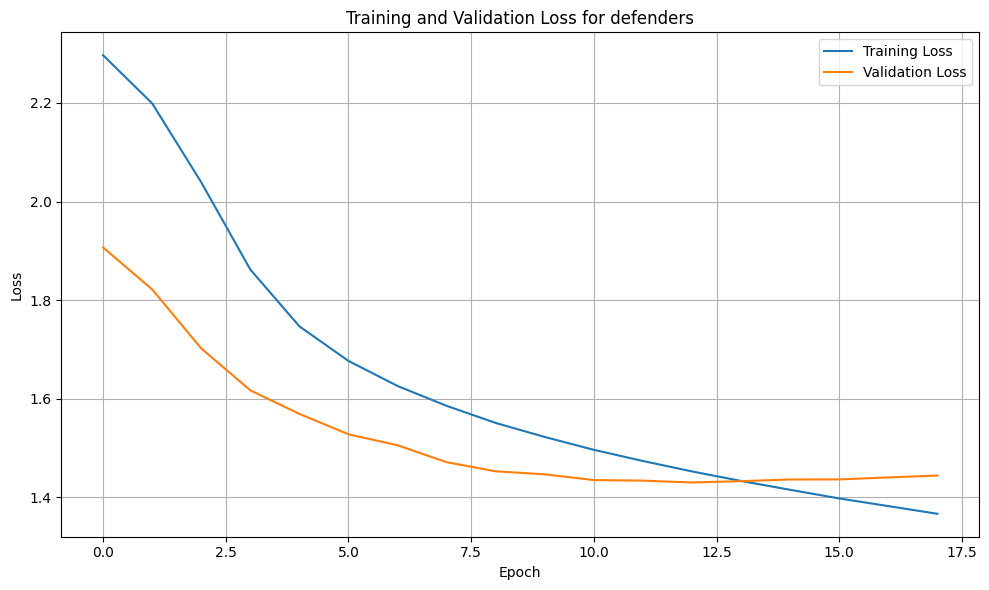

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 126 K  | train
1 | fc    | Linear | 21.7 K | train
-----------------------------------------
148 K     Trainable params
0         Non-trainable params
148 K     Total params
0.594     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


         Player Name       GW1       GW2       GW3       GW4
0    aaron cresswell  1.188530  1.952769  2.164898  2.265302
1  abdul rahman baba  0.069609  0.024723  0.048076  0.051524
2      adam matthews -0.016818  0.022385 -0.003668 -0.008209
3         adam smith  1.011010  1.015383  1.068840  1.071765
4     alberto moreno  0.009531  0.001535 -0.022280 -0.015734
Train Data Shape: (262, 1, 215)
Validation Data Shape: (3, 1, 215)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

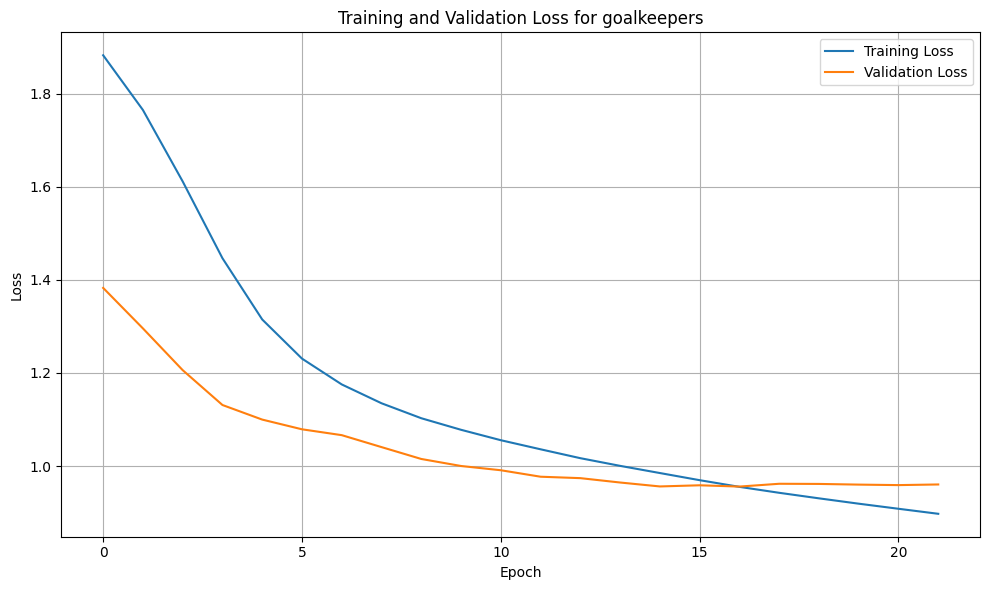

                      Player Name       GW1       GW2       GW3       GW4
0                   adam federici -0.005943 -0.071441 -0.089104 -0.102878
1  adrian san miguel del castillo  0.056383 -0.015525 -0.054963 -0.078750
2             alexander manninger  0.014872  0.036203  0.033544  0.034445
3                   alex mccarthy  0.302490  0.484513  0.574715  0.605823
4                  allan mcgregor -0.038413  0.016530  0.029079  0.031538


In [ ]:
f_pred_pf=train_and_predict(forwards, 'forwards', 100)
m_pred_pf=train_and_predict(midfielders, 'midfielders', 100)
d_pred_pf=train_and_predict(defenders, 'defenders', 100)
g_pred_pf=train_and_predict(goalkeepers, 'goalkeepers', 100)

Training Valuue (Cost) of Players

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/forwards exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 161 K  | train
1 | fc    | Linear | 30.5 K | train
-----------------------------------------
192 K     Trainable params
0         Non-trainable params
192 K     Total params
0.768     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


Train Data Shape: (262, 1, 302)
Validation Data Shape: (3, 1, 302)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

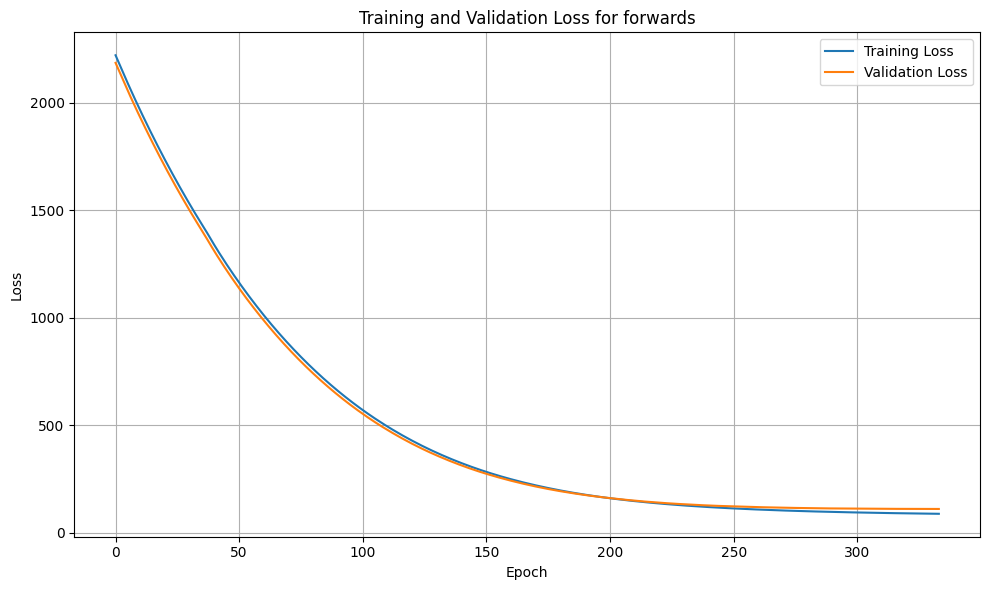

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/midfielders exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 399 K  | train
1 | fc    | Linear | 90.6 K | train
-----------------------------------------
490 K     Trainable params
0         Non-trainable params
490 K     Total params
1.961     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


      Player Name        GW1        GW2        GW3        GW4
0  abel hernandez  42.531528  42.531528  42.531528  42.531528
1  adama diomande  40.614235  40.614235  40.614235  40.614235
2      ahmed musa  43.844353  43.844353  43.844353  43.844353
3      andre gray  52.122086  52.122086  52.122086  52.122086
4    andy carroll  50.462440  50.462440  50.462440  50.462440
Train Data Shape: (262, 1, 897)
Validation Data Shape: (3, 1, 897)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

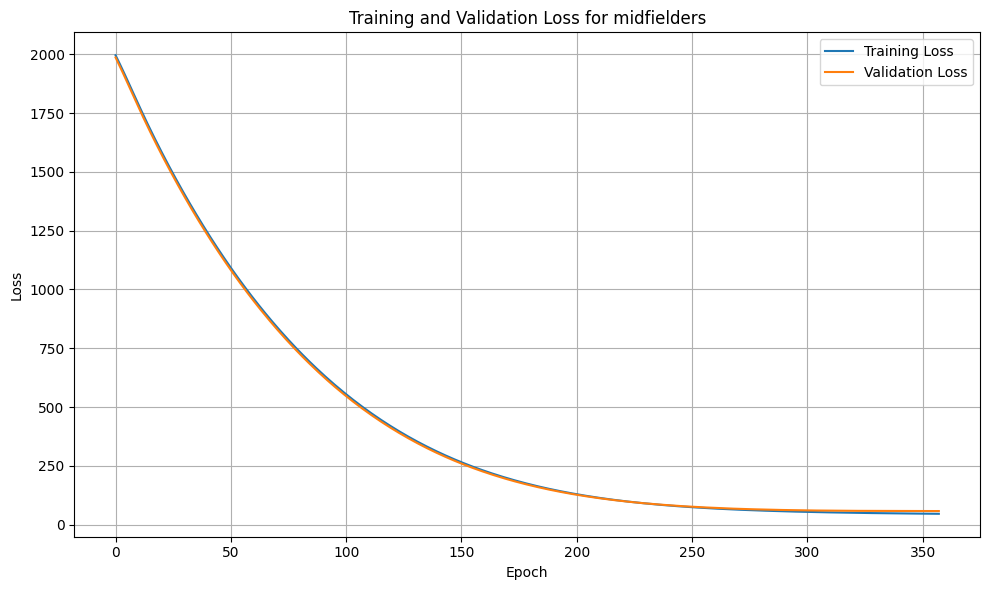

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/defenders exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 313 K  | train
1 | fc    | Linear | 68.9 K | train
-----------------------------------------
382 K     Trainable params
0         Non-trainable params
382 K     Total params
1.530     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


          Player Name        GW1        GW2        GW3        GW4
0        aaron lennon  46.777515  46.777515  46.777515  46.777515
1        aaron ramsey  51.988415  51.988415  51.988415  51.988415
2  abdoulaye doucoure  51.152500  51.152500  51.152500  51.152500
3        adam clayton  40.253445  40.253445  40.253445  40.253445
4        adam forshaw  42.651112  42.651112  42.651112  42.651112
Train Data Shape: (262, 1, 682)
Validation Data Shape: (3, 1, 682)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

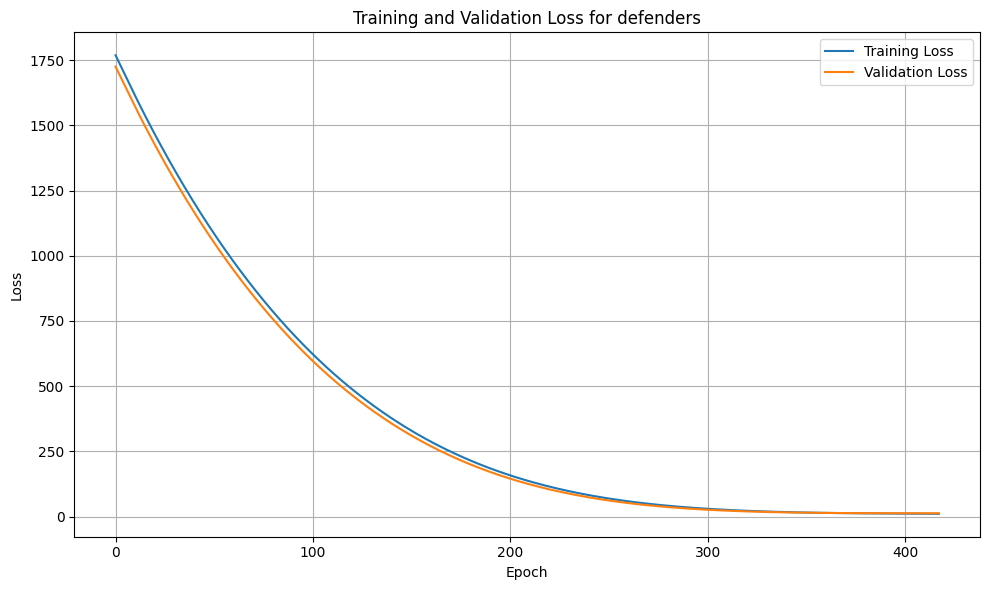

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/checkpoints/goalkeepers exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params | Mode 
-----------------------------------------
0 | lstm1 | LSTM   | 126 K  | train
1 | fc    | Linear | 21.7 K | train
-----------------------------------------
148 K     Trainable params
0         Non-trainable params
148 K     Total params
0.594     Total estimated model params size (MB)
2         Modules in train mode
0         Modules in eval mode


         Player Name        GW1        GW2        GW3        GW4
0    aaron cresswell  48.563107  48.563107  48.563107  48.563107
1  abdul rahman baba  41.469467  41.469467  41.469467  41.469467
2      adam matthews  39.649921  39.649921  39.649921  39.649921
3         adam smith  42.802395  42.802395  42.802395  42.802395
4     alberto moreno  41.117500  41.117500  41.117500  41.117500
Train Data Shape: (262, 1, 215)
Validation Data Shape: (3, 1, 215)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (9) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

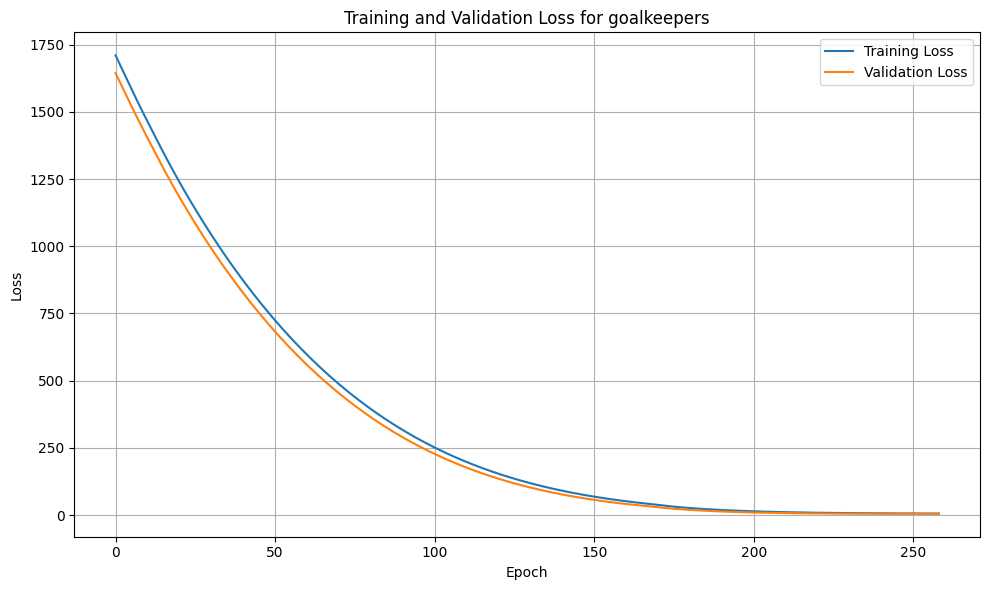

                      Player Name        GW1        GW2        GW3        GW4
0                   adam federici  40.030605  40.030605  40.030605  40.030605
1  adrian san miguel del castillo  42.230019  42.230019  42.230019  42.230019
2             alexander manninger  39.589088  39.589088  39.589088  39.589088
3                   alex mccarthy  42.920742  42.920742  42.920742  42.920742
4                  allan mcgregor  40.037979  40.037979  40.037979  40.037979


In [ ]:
# Train and predict for each position
f_pred_cf=train_and_predict(forwards_c, 'forwards', 800)
m_pred_cf=train_and_predict(midfielders_c, 'midfielders', 800)
d_pred_cf=train_and_predict(defenders_c, 'defenders',800)
g_pred_cf=train_and_predict(goalkeepers_c, 'goalkeepers', 800)

### LSTM Results

In [ ]:
def rename_columns_based_on_week(df, start_week, end_week):
    # Crear la lista de nombres de columnas GW
    gw_columns = [i for i in range(start_week, end_week + 1)]

    # Crear el nuevo nombre de columnas incluyendo "Player Name" y "element_type"
    new_column_names = ['Player Name'] + gw_columns + ['element_type']

    # Verificar si el número de columnas es correcto
    if len(new_column_names) != len(df.columns):
        raise ValueError("El número de columnas proporcionadas no coincide con el DataFrame.")

    # Renombrar las columnas
    df.columns = new_column_names
    return df

Value

In [ ]:
#af= pd.read_csv("combined_df_c_13_16.csv", index_col=0)
#af.head()
#i=13
#j=i+3
#rename_columns_based_on_week(af,i,j)
combined_df_c_1_38=[]
for i in range(5,41,4):
 if i==37:
  j=i+1
 else:
  j=i+3
 af= pd.read_csv(f"combined_df_c_{i}_{j}.csv", index_col=0)
 rename_columns_based_on_week(af,i,j)
 af.drop(columns=["element_type"], inplace=True)
  # Convertimos el DataFrame en formato largo (unstack), donde tendremos dos columnas: valores y semanas
 af_long = af.melt(id_vars=["Player Name"], var_name="GW", value_name="Value")

  # Añadimos el DataFrame convertido a la lista
 combined_df_c_1_38.append(af_long)
combined_df_c_1_38=pd.concat(combined_df_c_1_38, ignore_index=True)
combined_df_c_1_38

 #rename_columns_based_on_week(af,i,j

,Player Name,GW,Value
0,abel hernandez,5,41.509110
1,adama diomande,5,39.979774
2,ahmed musa,5,42.760193
3,andre gray,5,49.160690
4,andy carroll,5,47.978250
...,...,...,...
78567,joe gauci,38,39.597893
78568,dermot mee,38,39.643936
78569,teddy sharman-lowe,38,39.618454
78570,callan mckenna,38,39.624130


In [ ]:
folder_path = "/content/drive/MyDrive/fpl/2023-2024"
code_1="utf-8"
code_2="utf-8"
df_1_2023_2024_results = dataframes_from_csv(folder_path,code_1,code_2)
df_1_2023_2024_results.rename(columns={'team_code': 'team_y'}, inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29725 entries, 0 to 29724
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   name                        29725 non-null  object 
 1   position                    29725 non-null  object 
 2   team                        29725 non-null  object 
 3   xP                          29725 non-null  float64
 4   assists                     29725 non-null  int64  
 5   bonus                       29725 non-null  int64  
 6   bps                         29725 non-null  int64  
 7   clean_sheets                29725 non-null  int64  
 8   creativity                  29725 non-null  float64
 9   element                     29725 non-null  int64  
 10  expected_assists            29725 non-null  float64
 11  expected_goal_involvements  29725 non-null  float64
 12  expected_goals              29725 non-null  float64
 13  expected_goals_conceded     297

In [ ]:
from sklearn.metrics import mean_squared_error
#df_1_2023_2024_results=df_1_2023_2024_results[df_1_2023_2024_results["GW"]>4]
df_1_2023_2024_results.rename(columns={'name': 'Player Name'}, inplace=True)
merged_df = pd.merge(combined_df_c_1_38, df_1_2023_2024_results[['Player Name',"value","GW"]], on=['Player Name', 'GW'], how='left')
merged_df.fillna(40, inplace=True)
# Calculate MSE using sklearn
mse = mean_squared_error(merged_df['value'], merged_df['Value'])
print(f"Root Mean Squared Error (RMSE): {mse**(1/2)}")

Root Mean Squared Error (RMSE): 6.825410676273195


Points

In [ ]:
combined_df_p_1_38=[]
for i in range(5,41,4):
 if i==37:
  j=i+1
 else:
  j=i+3
 af= pd.read_csv(f"combined_df_p_{i}_{j}.csv", index_col=0)
 rename_columns_based_on_week(af,i,j)
 af.drop(columns=["element_type"], inplace=True)
  # Convertimos el DataFrame en formato largo (unstack), donde tendremos dos columnas: valores y semanas
 af_long = af.melt(id_vars=["Player Name"], var_name="GW", value_name="points")

  # Añadimos el DataFrame convertido a la lista
 combined_df_p_1_38.append(af_long)
combined_df_p_1_38=pd.concat(combined_df_p_1_38, ignore_index=True)
combined_df_p_1_38

,Player Name,GW,points
0,abel hernandez,5,-0.379138
1,adama diomande,5,-0.344339
2,ahmed musa,5,-0.289317
3,andre gray,5,-0.038054
4,andy carroll,5,-0.167142
...,...,...,...
78567,joe gauci,38,-0.034959
78568,dermot mee,38,-0.041595
78569,teddy sharman-lowe,38,-0.022022
78570,callan mckenna,38,0.021739


In [ ]:
#df_1_2023_2024_results=df_1_2023_2024_results[df_1_2023_2024_results["GW"]>4]
df_1_2023_2024_results.rename(columns={'name': 'Player Name'}, inplace=True)
merged_df = pd.merge(combined_df_p_1_38, df_1_2023_2024_results[['Player Name',"total_points","GW"]], on=['Player Name', 'GW'], how='left')
merged_df.fillna(0, inplace=True)
# Calculate MSE using sklearn
mse = mean_squared_error(merged_df['points'], merged_df['total_points'])
print(f"Root Mean Squared Error (RMSE): {mse**(1/2)}")

Root Mean Squared Error (RMSE): 1.3065280705481177


## Fantasy Team

In [ ]:
pip install pyomo

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 66.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.6/49.6 kB 3.2 MB/s eta 0:00:00


In [ ]:
!apt-get install -y -qq coinor-libipopt-dev

Selecting previously unselected package libscalapack-openmpi2.1:amd64.
(Reading database ... 123620 files and directories currently installed.)
Preparing to unpack .../00-libscalapack-openmpi2.1_2.1.0-4_amd64.deb ...
Unpacking libscalapack-openmpi2.1:amd64 (2.1.0-4) ...
Selecting previously unselected package libmumps-5.4:amd64.
Preparing to unpack .../01-libmumps-5.4_5.4.1-2_amd64.deb ...
Unpacking libmumps-5.4:amd64 (5.4.1-2) ...
Selecting previously unselected package libmumps-headers-dev.
Preparing to unpack .../02-libmumps-headers-dev_5.4.1-2_all.deb ...
Unpacking libmumps-headers-dev (5.4.1-2) ...
Selecting previously unselected package libscotch-6.1:amd64.
Preparing to unpack .../03-libscotch-6.1_6.1.3-1_amd64.deb ...
Unpacking libscotch-6.1:amd64 (6.1.3-1) ...
Selecting previously unselected package libmumps-seq-5.4:amd64.
Preparing to unpack .../04-libmumps-seq-5.4_5.4.1-2_amd64.deb ...
Unpacking libmumps-seq-5.4:amd64 (5.4.1-2) ...
Selecting previously unselected package coin

In [ ]:
!apt-get install -y -qq glpk-utils

Selecting previously unselected package libsuitesparseconfig5:amd64.
(Reading database ... 123834 files and directories currently installed.)
Preparing to unpack .../libsuitesparseconfig5_1%3a5.10.1+dfsg-4build1_amd64.deb ...
Unpacking libsuitesparseconfig5:amd64 (1:5.10.1+dfsg-4build1) ...
Selecting previously unselected package libamd2:amd64.
Preparing to unpack .../libamd2_1%3a5.10.1+dfsg-4build1_amd64.deb ...
Unpacking libamd2:amd64 (1:5.10.1+dfsg-4build1) ...
Selecting previously unselected package libcolamd2:amd64.
Preparing to unpack .../libcolamd2_1%3a5.10.1+dfsg-4build1_amd64.deb ...
Unpacking libcolamd2:amd64 (1:5.10.1+dfsg-4build1) ...
Selecting previously unselected package libglpk40:amd64.
Preparing to unpack .../libglpk40_5.0-1_amd64.deb ...
Unpacking libglpk40:amd64 (5.0-1) ...
Selecting previously unselected package glpk-utils.
Preparing to unpack .../glpk-utils_5.0-1_amd64.deb ...
Unpacking glpk-utils (5.0-1) ...
Setting up libsuitesparseconfig5:amd64 (1:5.10.1+dfsg-4b

In [ ]:
!which glpsol

/usr/bin/glpsol


### Data Prep:

In [ ]:
f_pred_pf

,Player Name,GW1,GW2,GW3,GW4,element_type
0,abel hernandez,-0.157960,-0.005250,-0.017262,-0.043080,4
1,adama diomande,0.023396,0.021669,0.001367,-0.093942,4
2,ahmed musa,-0.559779,-0.091748,-0.145161,-0.139885,4
3,andre gray,-0.364754,-0.149770,-0.078430,-0.078569,4
4,andy carroll,-0.046823,0.092195,0.205970,0.144741,4
...,...,...,...,...,...,...
303,sasa kalajdzic,0.216080,0.076127,0.039194,0.023415,4
304,jacob brown,-0.021774,0.054217,0.002235,-0.020255,4
305,deivid washington de souza eugenio,-0.099856,-0.034196,-0.021003,0.016371,4
306,norberto bercique gomes betuncal,-0.000333,-0.074252,-0.004540,0.053294,4


In [ ]:
f_pred_pf["element_type"]=4
m_pred_pf["element_type"]=3
d_pred_pf["element_type"]=2
g_pred_pf["element_type"]=1
f_pred_cf["element_type"]=4
m_pred_cf["element_type"]=3
d_pred_cf["element_type"]=2
g_pred_cf["element_type"]=1

In [ ]:
combined_df_p = pd.concat([f_pred_pf, m_pred_pf,d_pred_pf,g_pred_pf], ignore_index=True)
combined_df_c = pd.concat([f_pred_cf, m_pred_cf,d_pred_cf,g_pred_cf], ignore_index=True)
pd.DataFrame(combined_df_p).to_csv("combined_df_p_5_8.csv")
pd.DataFrame(combined_df_c).to_csv("combined_df_c_5_8.csv")

In [ ]:
#combined_df_c = pd.read_csv("combined_df_c_13_16.csv", index_col=0)
#combined_df_p = pd.read_csv("combined_df_p_13_16.csv", index_col=0)

In [ ]:
df_melted_p = pd.melt(combined_df_p, id_vars=['Player Name', 'element_type'], var_name='GW', value_name='Prediction') # Include 'element_type' in id_vars
# Extraer el número de Gameweek y convertirlo en entero
df_melted_p['GW'] = df_melted_p['GW'].str.extract('(\d+)').astype(int)
# Mostrar el DataFrame resultante
print(df_melted_p.head())


      Player Name  element_type  GW  Prediction
0  abel hernandez             4   1   -0.769159
1  adama diomande             4   1   -0.010471
2      ahmed musa             4   1    0.114889
3      andre gray             4   1   -1.158301
4    andy carroll             4   1   -0.603734


In [ ]:
df_1_2022_2023.rename(columns={'name': 'Player Name'}, inplace=True)
df_1_2022_2023.info()
df_1_2023_2024.rename(columns={'name': 'Player Name'}, inplace=True)
unique_players_names_t_1=df_1_2023_2024["Player Name"].unique()
avg_minutes_played = df_1_2023_2024.groupby('Player Name')['minutes'].mean()
unique_players_names = avg_minutes_played[avg_minutes_played > 15].index.tolist()
# Convert unique_players_names to a pandas Series
unique_players_names = pd.Series(unique_players_names)
# filtering
unique_players_names = unique_players_names[unique_players_names.isin(unique_players_names_t_1)]
# Filter df_melted_p to include only players that are in unique_player_names
filtered_df_p = df_melted_p[df_melted_p['Player Name'].isin(unique_players_names)]
filtered_df_p.loc[filtered_df_p['Player Name'] == 'cody gakpo', 'element_type'] = 4
filtered_df_p = filtered_df_p[~((filtered_df_p['Player Name'] == 'brennan johnson') & (filtered_df_p['element_type'] != 4))]
filtered_df_p = filtered_df_p[~((filtered_df_p['Player Name'] == 'trent alexander-arnold') & (filtered_df_p['element_type'] != 2))]

# Display the resulting DataFrame
print(filtered_df_p.head())
#print(filtered_df_p_real.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26581 entries, 0 to 26580
Data columns (total 44 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Player Name                 26581 non-null  object 
 1   position                    26581 non-null  object 
 2   team                        26581 non-null  object 
 3   xP                          26581 non-null  float64
 4   assists                     26581 non-null  int64  
 5   bonus                       26581 non-null  int64  
 6   bps                         26581 non-null  int64  
 7   clean_sheets                26581 non-null  int64  
 8   creativity                  26581 non-null  float64
 9   element                     26581 non-null  int64  
 10  expected_assists            26581 non-null  float64
 11  expected_goal_involvements  26581 non-null  float64
 12  expected_goals              26581 non-null  float64
 13  expected_goals_conceded     265

In [ ]:
first_cost=df_1_2023_2024[df_1_2023_2024["GW"]==(min(df_1_2023_2024["GW"])+16)][["Player Name","value"]]
first_cost.rename({"value":"GW1"},axis=1, inplace=True)


In [ ]:
# Eliminar duplicados en df_teams para asegurarse de que cada jugador tiene solo un equipo asociado
df_teams_unique = df_1_2023_2024[["Player Name","team_y"]].drop_duplicates(subset=['Player Name'])
filtered_df_p = pd.merge(filtered_df_p, df_teams_unique, on='Player Name', how='left')
#filtered_df_p_real = pd.merge(filtered_df_p_real, df_teams_unique, on='Player Name', how='left')
print(filtered_df_p)
#print(filtered_df_p_real)

            Player Name  element_type  GW  Prediction  team_y
0         callum wilson             4   1    2.607936       4
1         danny welbeck             4   1    1.104325      36
2          divock origi             4   1   -0.511256      17
3          jarrod bowen             4   1   -0.028641      21
4       marcus rashford             4   1   -0.065864       1
...                 ...           ...  ..         ...     ...
1579    thomas kaminski             1   4    1.482616     102
1580       mark flekken             1   4    2.780297      94
1581  guglielmo vicario             1   4    4.255863       6
1582    bart verbruggen             1   4    0.857228      36
1583        andre onana             1   4    2.198138       1

[1584 rows x 5 columns]


In [ ]:
# Merge the datasets based on 'Player Name'
# Using 'left' join to ensure that the original dataset remains intact and only replaces GW1 where possible
merged_data = pd.merge(combined_df_c, first_cost[['Player Name', 'GW1']], on='Player Name', how='left', suffixes=('_old', '_new'))

# Replace the old GW1 values with the new GW1 values, where available
merged_data['GW1'] = merged_data['GW1_new'].combine_first(merged_data['GW1_old'])

# Drop the temporary columns used during merging
merged_data.drop(columns=['GW1_old', 'GW1_new'], inplace=True)
combined_df_c=merged_data
# Display the updated dataset


In [ ]:
filtered_df_p['team_y'].unique()
teams_to_include = filtered_df_p['team_y'].unique()
filtered_df_p_2 = filtered_df_p[filtered_df_p['team_y'].isin(teams_to_include)]


In [ ]:
df_melted_c = pd.melt(combined_df_c, id_vars=['Player Name', 'element_type'], var_name='GW', value_name='Prediction') # Include 'element_type' in id_vars
df_melted_c['GW'] = df_melted_c['GW'].str.extract('(\d+)').astype(int)
print(df_melted_c.head())

      Player Name  element_type  GW  Prediction
0  abel hernandez             4   2   41.744854
1  adama diomande             4   2   39.964703
2      ahmed musa             4   2   42.638229
3      andre gray             4   2   49.116997
4    andy carroll             4   2   48.179840


In [ ]:
filtered_df_c = df_melted_c[df_melted_c['Player Name'].isin(unique_players_names)]
print(filtered_df_c.head())
filtered_df_c[filtered_df_c["Player Name"]=="trent alexander-arnold"]

        Player Name  element_type  GW  Prediction
10    callum wilson             4   2   57.408768
20    danny welbeck             4   2   55.034306
24     divock origi             4   2   49.949215
33     jarrod bowen             4   2   40.031273
47  marcus rashford             4   2   52.842014


,Player Name,element_type,GW,Prediction
547,trent alexander-arnold,3,2,40.180531
1564,trent alexander-arnold,2,2,54.816639
2830,trent alexander-arnold,3,3,40.180531
3847,trent alexander-arnold,2,3,54.816639
5113,trent alexander-arnold,3,4,40.180531
6130,trent alexander-arnold,2,4,54.816639
7396,trent alexander-arnold,3,1,79.000000
8413,trent alexander-arnold,2,1,79.000000


In [ ]:
# Eliminar duplicados en df_teams para asegurarse de que cada jugador tiene solo un equipo asociado
df_teams_unique = df_1_2023_2024[["Player Name","team_y"]].drop_duplicates(subset=['Player Name'])

filtered_df_c = pd.merge(filtered_df_c, df_teams_unique, on='Player Name', how='left')
filtered_df_c.loc[filtered_df_c['Player Name'] == 'gakpo', 'element_type'] = 4
filtered_df_c = filtered_df_c[~((filtered_df_c['Player Name'] == 'brennan johnson') & (filtered_df_c['element_type'] != 4))]
filtered_df_c = filtered_df_c[~((filtered_df_c['Player Name'] == 'trent alexander-arnold') & (filtered_df_c['element_type'] != 2))]

#filtered_df_c_real = pd.merge(filtered_df_c_real, df_teams_unique, on='Player Name', how='left')
print(filtered_df_c)
#print(filtered_df_c_real)

            Player Name  element_type  GW  Prediction  team_y
0         callum wilson             4   2   57.408768       4
1         danny welbeck             4   2   55.034306      36
2          divock origi             4   2   49.949215      17
3          jarrod bowen             4   2   40.031273      21
4       marcus rashford             4   2   52.842014       1
...                 ...           ...  ..         ...     ...
1587    thomas kaminski             1   1   45.000000     102
1588       mark flekken             1   1   45.000000      94
1589  guglielmo vicario             1   1   52.000000       6
1590    bart verbruggen             1   1   44.000000      36
1591        andre onana             1   1   48.000000       1

[1584 rows x 5 columns]


In [ ]:
filtered_df_c_2 = filtered_df_c[filtered_df_c['team_y'].isin(teams_to_include)]
filtered_df_c_2.sort_values(by=['GW'], inplace=True)
# Replace GW values
filtered_df_c_2['GW'] = filtered_df_c_2['GW'].replace({1: 17, 2: 18, 3: 19, 4: 20})

In [ ]:
filtered_df_p_2['GW'] = filtered_df_p_2['GW'].replace({1: 17, 2: 18, 3: 19, 4: 20})
len(filtered_df_p_2["Player Name"])

1584

In [ ]:
#len(filtered_df_p_real_2["Player Name"])

In [ ]:
len(filtered_df_c_2["Player Name"])

1584

In [ ]:
filtered_df_c_2[filtered_df_c_2["Player Name"]=="brennan johnson"]

,Player Name,element_type,GW,Prediction,team_y
1222,brennan johnson,4,13,58.000000,6
28,brennan johnson,4,14,41.416229,6
426,brennan johnson,4,15,41.416229,6
824,brennan johnson,4,16,41.416229,6


In [ ]:
#len(filtered_df_c_real_2["Player Name"])

1204

In [ ]:
# Extract necessary columns
players = filtered_df_p_2['Player Name'].unique()
gameweeks = filtered_df_p_2['GW'].unique()
clubs = filtered_df_p_2['team_y'].unique()
element_type=filtered_df_p_2['element_type'].unique()

print(gameweeks)
print(element_type)
print(clubs)
# Create mappings for players, clubs, and positions
player_club_map = dict(zip(filtered_df_p_2['Player Name'], filtered_df_p_2['team_y']))

[13 14 15 16]
[4 3 2 1]
[  4  36  17  21   1  11  91  49   3  31  90  54  94   6   7  14  43  39
 102   8]


In [ ]:
pt_data = {(row['Player Name'], row['GW']): row['Prediction'] for index, row in filtered_df_p_2.iterrows()}
pt_data={key: round(value) for key, value in pt_data.items()}

In [ ]:
#pt_data_real = {(row['Player Name'], row['GW']): row['Real Value'] for index, row in filtered_df_p_real_2.iterrows()}
#pt_data_real={key: round(value) for key, value in pt_data_real.items()}

In [ ]:
print(pt_data)
#print(pt_data_real)

{('callum wilson', 13): 3, ('danny welbeck', 13): 1, ('divock origi', 13): -1, ('jarrod bowen', 13): 5, ('marcus rashford', 13): 4, ('dominic calvert-lewin', 13): 1, ('dominic solanke', 13): 4, ('oliver mcburnie', 13): 0, ('gabriel fernando de jesus', 13): 2, ('jordan ayew', 13): 2, ('jay rodriguez', 13): 0, ('chris wood', 13): 2, ('dwight mcneil', 13): 3, ('raul jimenez', 13): 2, ('joelinton cassio apolinario de lira', 13): 2, ('neal maupay', 13): 1, ('anthony gordon', 13): 3, ('joao pedro junqueira de jesus', 13): 2, ('michail antonio', 13): 0, ('richarlison de andrade', 13): 1, ('timo werner', 13): -1, ('ollie watkins', 13): 5, ('jean-philippe mateta', 13): 2, ('william osula', 13): 0, ('ivan toney', 13): 2, ('cameron archer', 13): 1, ('odsonne edouard', 13): 3, ('evan ferguson', 13): 2, ('brennan johnson', 13): 1, ('diogo teixeira da silva', 13): 2, ('erling haaland', 13): 5, ('taiwo awoniyi', 13): 2, ('bryan mbeumo', 13): 3, ('julian alvarez', 13): 4, ('kai havertz', 13): 2, ('edd

In [ ]:
cost_data=0
cost_data = {(row['Player Name'], row['GW']): row['Prediction'] for index, row in filtered_df_c_2.iterrows()}
cost_data={key: round(value) for key, value in cost_data.items()}

In [ ]:
#cost_data_real = {(row['Player Name'], row['GW']): row['Real Value'] for index, row in filtered_df_c_real_2.iterrows()}
#cost_data_real={key: round(value) for key, value in cost_data_real.items()}

In [ ]:
print(cost_data)

{('andre onana', 13): 48, ('kai havertz', 13): 71, ('marcus rashford', 13): 86, ('conor gallagher', 13): 54, ('jacob ramsey', 13): 59, ('thomas partey', 13): 48, ('said benrahma', 13): 56, ('elliot anderson', 13): 43, ('jakub moder', 13): 44, ('martin odegaard', 13): 83, ('jack harrison', 13): 55, ('anthony elanga', 13): 50, ('yoane wissa', 13): 59, ('albert sambi lokonga', 13): 49, ('vitaly janelt', 13): 53, ('bryan mbeumo', 13): 69, ('frank onyeka', 13): 49, ('mathias jensen', 13): 54, ('saman ghoddos', 13): 45, ('leon bailey', 13): 55, ('michael olise', 13): 58, ('christian norgaard', 13): 54, ('eberechi eze', 13): 62, ('anthony gordon', 13): 58, ('tommy doyle', 13): 44, ('youri tielemans', 13): 56, ('james garner', 13): 49, ('tahith chong', 13): 48, ('harvey elliott', 13): 48, ('arnaut danjuma groeneveld', 13): 53, ('ben osborn', 13): 48, ('douglas luiz soares de paulo', 13): 56, ('jack grealish', 13): 72, ('jeffrey schlupp', 13): 49, ('john mcginn', 13): 55, ('leandro trossard', 1

In [ ]:
#print(cost_data_real)

{('callum wilson', 1): 70, ('danny ings', 1): 50, ('danny welbeck', 1): 55, ('jamie vardy', 1): 55, ('jarrod bowen', 1): 75, ('marcus rashford', 1): 70, ('dominic calvert-lewin', 1): 60, ('gabriel fernando de jesus', 1): 70, ('jordan ayew', 1): 55, ('chris wood', 1): 60, ('dwight mcneil', 1): 55, ('joelinton cassio apolinario de lira', 1): 60, ('neal maupay', 1): 50, ('anthony gordon', 1): 75, ('joao pedro junqueira de jesus', 1): 55, ('armando broja', 1): 55, ('michail antonio', 1): 0, ('richarlison de andrade', 1): 0, ('ollie watkins', 1): 90, ('carlos vinicius alves morais', 1): 50, ('jean-philippe mateta', 1): 75, ('patson daka', 1): 50, ('ivan toney', 1): 75, ('cameron archer', 1): 50, ('odsonne edouard', 1): 55, ('evan ferguson', 1): 55, ('brennan johnson', 1): 65, ('diogo teixeira da silva', 1): 75, ('erling haaland', 1): 150, ('taiwo awoniyi', 1): 60, ('bryan mbeumo', 1): 70, ('julian alvarez', 1): 70, ('kai havertz', 1): 0, ('eddie nketiah', 1): 60, ('darwin nunez ribeiro', 1)

In [ ]:
len(cost_data.keys())

1500

In [ ]:
position_map = dict(zip(filtered_df_p_2['Player Name'], filtered_df_p_2['element_type']))

##### Fist Run

In [ ]:
pip install pyomo

In [ ]:
from pyomo.environ import *
import random
random.seed(42)
week=max(gameweeks)
time=week+1
time_1=time+1

gameweeks = list(range((min(gameweeks))-1, time))
gameweeks_1 = list(range((min(gameweeks)), time_1))
gameweek_chip=list(range((min(gameweeks)), time))

In [ ]:
def calculate_sell_data(cost_data):
    """
    Calculate the sell price for each player and gameweek based on the initial value and the cost data.

    Parameters:
    - cost_data (dict): A dictionary where the keys are tuples of (player, gameweek) and the values are costs.

    Returns:
    - sell_data (dict): A dictionary where the keys are tuples of (player, gameweek) and the values are the calculated sell prices.
    """
    sell_data = {}
    initial_values = {}

    # Iterate over each player and gameweek in cost_data
    for (player, gw), cost in cost_data.items():
        # Check if the player's initial value has already been set
        if player not in initial_values:
            initial_values[player] = cost  # Set the first cost as the initial value

        initial_value = initial_values[player]

        # Calculate the sell price based on the initial value
        if cost > initial_value:
            profit = cost - initial_value
            sell_price = initial_value + 0.5 * profit
        else:
            sell_price = cost

        # Round the sell price to 2 decimal places and store it in sell_data
        sell_data[(player, gw)] = round(sell_price, 2)

    return sell_data

# Initialize position lists for each club
club_gks = {club: [] for club in clubs}
club_defs = {club: [] for club in clubs}
club_mids = {club: [] for club in clubs}
club_fwds = {club: [] for club in clubs}

# Populate the position lists for each club based on real data
for club in clubs:
    for player in players:
        if player_club_map.get(player) == club:
            pos = position_map.get(player)
            if pos == 1:
                club_gks[club].append(player)
            elif pos == 2:
                club_defs[club].append(player)
            elif pos == 3:
                club_mids[club].append(player)
            elif pos == 4:
                club_fwds[club].append(player)

# Combine all players into a single list
GK = [p for p in players if position_map.get(p) == 1]
DEF = [p for p in players if position_map.get(p) == 2]
MID = [p for p in players if position_map.get(p) == 3]
FWD = [p for p in players if position_map.get(p) == 4]

# Map each player to their club and position
position_map_str = {1: 'GK', 2: 'DEF', 3: 'MID', 4: 'FWD'}
position_map_str.update({player: position_map_str.get(position_map.get(player), 'UNK') for player in players})

# Verify the generated data
for club in clubs:
    print(f"Club {club}:")
    print(f"  Goalkeepers: {club_gks[club]}")
    print(f"  Defenders: {club_defs[club]}")
    print(f"  Midfielders: {club_mids[club]}")
    print(f"  Forwards: {club_fwds[club]}")
    print()

kappa_l_data = {l: l * 0.01 ** (l + 1) for l in range(1, 4)}
sell_data = calculate_sell_data(cost_data)
# Display some of the generated cost and sell data
print("\nPT Data (sample):")
for k, v in list(pt_data.items())[:10]:
    print(f"{k}: {v}")

print("\nCost Data (sample):")
for k, v in list(cost_data.items())[:20]:
    print(f"{k}: {v}")

print("\nSell Data (sample):")
for k, v in list(sell_data.items())[:20]:
    print(f"{k}: {v}")

# DEFINE PARAMETERS
random_gameweek = random.choice(gameweeks)
random_parameter_data = {t: 1 if t == random_gameweek else 0 for t in gameweeks}
i_t = .01  # constant such that i_t << 1
# Define parameters
alpha=100000
D = 5  # number of defenders required in selected squad
M = 5  # number of midfielders required in selected squad
F = 3  # number of forwards required in selected squad
C = 3  # maximum number of players allowed in selected squad from same team
E = 11  # number of players required in starting line-up
EK = 1  # number of goalkeepers required in starting line-up
ED = 3  # minimum number of defenders required in starting line-up
EM = 3  # minimum number of midfielders required in starting line-up
EF = 1  # minimum number of forwards required in starting line-up

# Define the model
model = ConcreteModel()
# Define sets
model.P = Set(initialize=players)  # List of players
model.T = Set(initialize=gameweeks)  # List of gameweeks
model.T_1=Set(initialize=gameweeks_1)
model.T_chip=Set(initialize=gameweek_chip)
model.L = RangeSet(1, 3)
model.C = Set(initialize=clubs)  # List of clubs
model.PlayerClubs = Set(model.C, initialize={c: [p for p in model.P if player_club_map.get(p) == c] for c in model.C})
model.GK = Set(initialize=[p for p in players if position_map.get(p) == 1])
model.DEF = Set(initialize=[p for p in players if position_map.get(p) == 2])
model.MID = Set(initialize=[p for p in players if position_map.get(p) == 3])
model.FWD = Set(initialize=[p for p in players if position_map.get(p) == 4])
model.pt = Param(model.P, model.T, initialize=pt_data)  # Expected points
model.R = Param(initialize=4)  # Penalty points for extra transfers
model.alpha = Param(model.T, initialize=alpha)  # alpha constant
model.kappa_l = Param(model.L, initialize=kappa_l_data)  # Priority weights (κ1 > κ2 > ... > κl)
model.BS = Param(initialize=1000)  # Remaining budget after Week 4
model.CB = Param(model.P, model.T, initialize=cost_data)  # Cost of player
model.CS = Param(model.P, model.T, initialize=sell_data)  # Selling price of player
model.Q_lower = Param(initialize=1)  # Maximum number of free transfers per gameweek
model.Q_upper = Param(initialize=2)  # Maximum number of free transfers per gameweek
model.B= Param(initialize=10000)
# Define variables
model.ypt = Var(model.P, model.T, within=Binary)
model.xpt = Var(model.P, model.T, within=Binary)
model.xfreehit = Var(model.P, model.T, within=Binary)
model.f_captain = Var(model.P, model.T, within=Binary)
model.v_captain = Var(model.P, model.T, within=Binary)
model.gptl = Var(model.P, model.T, model.L, within=Binary)
model.upt = Var(model.P, model.T, within=Binary)
model.ept = Var(model.P, model.T, within=Binary)
model.wildcard = Var(model.T, within=Binary)
model.bench_boost = Var(model.T, within=Binary)
model.free_hit = Var(model.T, within=Binary)
model.triple_captain = Var(model.P, model.T, within=Binary)
model.phi_pt = Var(model.P, model.T, within=Binary)
model.vt = Var(model.T, within=NonNegativeReals)
model.qt = Var(model.T_1, within=NonNegativeIntegers)
model.alpha_var = Var(model.T, within=NonNegativeIntegers)
model.art = Var(model.T, within=Binary)

# Check if pt_data has data for all players and gameweeks
i=0
for p in model.P:
    for t in model.T:
        if (p, t) not in pt_data:
            i=i+1
            #print(f"Warning: Missing expected points data for player {p} in gameweek {t}")
            pt_data[(p, t)] = 0
            if p in whole_player:
              pt_data[(p, t)] = 100
              print(p)
print(i)

# Check if sell_data has data for all players and gameweeks
i=0
for p in model.P:
    for t in model.T:
        if (p, t) not in sell_data:
            i=i+1
            #print(f"Warning: Missing expected data for player {p} in gameweek {t}")
            sell_data[(p, t)] = 0
print(i)

# Check if cost_data has data for all players and gameweeks
i=0
for p in model.P:
    for t in model.T:
        if (p, t) not in cost_data:
            i=i+1
            #print(f"Warning: Missing expected data for player {p} in gameweek {t}")
            cost_data[(p, t)] = 0
print(i)
random_gameweek = random.choice(gameweeks)
random_parameter_data = {t: 1 if t == random_gameweek else 0 for t in gameweeks}
i_t = .01  # constant such that i_t << 1
# Define parameters
alpha=100000
D = 5  # number of defenders required in selected squad
M = 5  # number of midfielders required in selected squad
F = 3  # number of forwards required in selected squad
C = 3  # maximum number of players allowed in selected squad from same team
E = 11  # number of players required in starting line-up
EK = 1  # number of goalkeepers required in starting line-up
ED = 3  # minimum number of defenders required in starting line-up
EM = 3  # minimum number of midfielders required in starting line-up
EF = 1  # minimum number of forwards required in starting line-up

# Define the model
model = ConcreteModel()
# Define sets
model.P = Set(initialize=players)  # List of players
model.T = Set(initialize=gameweeks)  # List of gameweeks
model.T_1=Set(initialize=gameweeks_1)
model.T_chip=Set(initialize=gameweek_chip)
model.L = RangeSet(1, 3)
model.C = Set(initialize=clubs)  # List of clubs
model.PlayerClubs = Set(model.C, initialize={c: [p for p in model.P if player_club_map.get(p) == c] for c in model.C})
model.GK = Set(initialize=[p for p in players if position_map.get(p) == 1])
model.DEF = Set(initialize=[p for p in players if position_map.get(p) == 2])
model.MID = Set(initialize=[p for p in players if position_map.get(p) == 3])
model.FWD = Set(initialize=[p for p in players if position_map.get(p) == 4])
model.pt = Param(model.P, model.T, initialize=pt_data)  # Expected points
model.R = Param(initialize=4)  # Penalty points for extra transfers
model.alpha = Param(model.T, initialize=alpha)  # alpha constant
model.kappa_l = Param(model.L, initialize=kappa_l_data)  # Priority weights (κ1 > κ2 > ... > κl)
model.BS = Param(initialize=1000)  # Remaining budget after Week 4
model.CB = Param(model.P, model.T, initialize=cost_data)  # Cost of player
model.CS = Param(model.P, model.T, initialize=sell_data)  # Selling price of player
model.Q_lower = Param(initialize=1)  # Maximum number of free transfers per gameweek
model.Q_upper = Param(initialize=2)  # Maximum number of free transfers per gameweek
model.B= Param(initialize=10000)
# Define variables
model.ypt = Var(model.P, model.T, within=Binary)
model.xpt = Var(model.P, model.T, within=Binary)
model.xfreehit = Var(model.P, model.T, within=Binary)
model.f_captain = Var(model.P, model.T, within=Binary)
model.v_captain = Var(model.P, model.T, within=Binary)
model.gptl = Var(model.P, model.T, model.L, within=Binary)
model.upt = Var(model.P, model.T, within=Binary)
model.ept = Var(model.P, model.T, within=Binary)
model.wildcard = Var(model.T, within=Binary)
model.bench_boost = Var(model.T, within=Binary)
model.free_hit = Var(model.T, within=Binary)
model.triple_captain = Var(model.P, model.T, within=Binary)
model.phi_pt = Var(model.P, model.T, within=Binary)
model.vt = Var(model.T, within=NonNegativeReals)
model.qt = Var(model.T_1, within=NonNegativeIntegers)
model.alpha_var = Var(model.T, within=NonNegativeIntegers)
model.art = Var(model.T, within=Binary)

In [ ]:
def objective_rule(model):
    return (sum(sum(model.pt[p,t]*model.ypt[p,t] + model.pt[p,t]*model.f_captain[p,t]+i_t*model.pt[p,t]*model.v_captain[p,t] + sum(model.kappa_l[l]*model.gptl[p,t,l]*model.pt[p,t] for l in model.L) + 2*model.triple_captain[p,t]*model.pt[p,t]
            for p in model.P) for t in model.T) - sum(model.R*model.alpha_var[t] for t in model.T))

model.obj = Objective(rule=objective_rule, sense=maximize)

# Constraints
# Gamechips constraints
def gamechip_constraints_rule1(model,t):
  if t==1:
    return model.wildcard[t] == 0
  else:
    return sum(model.wildcard[t] for t in model.T) <= 1
model.gamechip_constraints1 = Constraint(model.T, rule=gamechip_constraints_rule1)

def gamechip_constraints_rule2(model):
    return sum(model.bench_boost[t] for t in model.T) <= 1
model.gamechip_constraints2 = Constraint(rule=gamechip_constraints_rule2)

def gamechip_constraints_rule3(model,t):
  if t==1:
    return model.free_hit[t] == 0
  else:
    return sum(model.free_hit[t] for t in model.T) <= 1

model.gamechip_constraints3 = Constraint(model.T, rule=gamechip_constraints_rule3)

def gamechip_constraints_rule4(model):
    if len(model.T) > 2:  # Check if there are enough gameweeks
        return sum(model.wildcard[t] for t in model.T if t in range(1, len(model.T)//2)) <= 1
    else:
        return Constraint.Feasible  # Return Feasible if the range is empty
model.gamechip_constraints4 = Constraint(rule=gamechip_constraints_rule4)

def gamechip_constraints_rule5(model):
    return sum(model.wildcard[t] for t in model.T if t in range(len(model.T)//2, len(model.T))) <= 1
model.gamechip_constraints5 = Constraint(rule=gamechip_constraints_rule5)

def gamechip_constraints_rule6(model):
    return sum(model.triple_captain[p,t] for p in model.P for t in model.T) <= 1
model.gamechip_constraints6 = Constraint(rule=gamechip_constraints_rule6)

def gamechip_constraints_rule7(model):
    return sum(model.wildcard[t] + model.bench_boost[t] + model.free_hit[t] + sum(model.triple_captain[p,t] for p in model.P) for t in model.T) <= len(model.T)
model.gamechip_constraints7 = Constraint(rule=gamechip_constraints_rule7)

def gamechip_constraints_rule8(model, t):
    return model.wildcard[t] + model.bench_boost[t] + model.free_hit[t] + sum(model.triple_captain[p,t] for p in model.P) <= 1
model.gamechip_constraints8 = Constraint(model.T, rule=gamechip_constraints_rule8)

# Selected Squad Constraints
def selected_squad_constraints_rule1(model, t):
    return sum(model.xpt[p, t] for p in model.P) == 15
model.selected_squad_constraints1 = Constraint(model.T, rule=selected_squad_constraints_rule1)

def selected_squad_constraints_rule2(model, t):
    return sum(model.xpt[p, t] for p in model.GK) == 2
model.selected_squad_constraints2 = Constraint(model.T, rule=selected_squad_constraints_rule2)

def selected_squad_constraints_rule3(model, t):
    return sum(model.xpt[p, t] for p in model.DEF) == 5
model.selected_squad_constraints3 = Constraint(model.T, rule=selected_squad_constraints_rule3)

def selected_squad_constraints_rule4(model, t):
    return sum(model.xpt[p, t] for p in model.MID) == 5
model.selected_squad_constraints4 = Constraint(model.T, rule=selected_squad_constraints_rule4)

def selected_squad_constraints_rule5(model, t):
    return sum(model.xpt[p, t] for p in model.FWD) == 3
model.selected_squad_constraints5 = Constraint(model.T, rule=selected_squad_constraints_rule5)

def selected_squad_constraints_rule10(model, t,c):
    return sum(model.xpt[p, t] for p in model.PlayerClubs[c]) <= 3 # Iterate over players in the club
model.selected_squad_constraints10 = Constraint(model.T, model.C, rule=selected_squad_constraints_rule10)

def selected_squad_constraints_rule11(model,t,c):
    return sum(model.xfreehit[p, t] for p in model.PlayerClubs[c]) <= 3*model.free_hit[t]
model.selected_squad_constraints11 = Constraint(model.T, model.C,rule=selected_squad_constraints_rule11)


def selected_squad_constraints_rule6(model, t):
    return sum(model.xfreehit[p, t] for p in model.GK) == 2*model.free_hit[t]
model.selected_squad_constraints6 = Constraint(model.T, rule=selected_squad_constraints_rule6)

def selected_squad_constraints_rule7(model, t):
    return sum(model.xfreehit[p, t] for p in DEF) == 5*model.free_hit[t]
model.selected_squad_constraints7 = Constraint(model.T, rule=selected_squad_constraints_rule7)

def selected_squad_constraints_rule8(model, t):
    return sum(model.xfreehit[p, t] for p in MID) == 5*model.free_hit[t]
model.selected_squad_constraints8 = Constraint(model.T, rule=selected_squad_constraints_rule8)

def selected_squad_constraints_rule9(model, t):
    return sum(model.xfreehit[p, t] for p in FWD) == 3*model.free_hit[t]
model.selected_squad_constraints9 = Constraint(model.T, rule=selected_squad_constraints_rule9)

# Starting Lineup Constrains
def starting_lineup_constraints_rule1(model,t):
    return sum(model.ypt[p, t] for p in model.P) == 11+4*model.bench_boost[t]
model.starting_lineup_constraints1 = Constraint(model.T, rule=starting_lineup_constraints_rule1)

def starting_lineup_constraints_rule2(model, t):
    return sum(model.ypt[p, t] for p in model.GK) == 1
model.starting_lineup_constraints2 = Constraint(model.T, rule=starting_lineup_constraints_rule2)

def starting_lineup_constraints_rule3(model, t):
    return sum(model.ypt[p, t] for p in model.DEF) >= 3
model.starting_lineup_constraints3 = Constraint(model.T, rule=starting_lineup_constraints_rule3)

def starting_lineup_constraints_rule4(model, t):
    return sum(model.ypt[p, t] for p in model.MID) >= 3
model.starting_lineup_constraints4 = Constraint(model.T, rule=starting_lineup_constraints_rule4)

def starting_lineup_constraints_rule5(model, t):
    return sum(model.ypt[p, t] for p in model.FWD) >= 1

model.starting_lineup_constraints5 = Constraint(model.T, rule=starting_lineup_constraints_rule5)

def starting_lineup_constraints_rule6(model,p,t):
    return model.ypt[p, t] <= model.xfreehit[p, t] + model.phi_pt[p, t]
model.starting_lineup_constraints6 = Constraint(model.P,model.T, rule=starting_lineup_constraints_rule6)

def starting_lineup_constraints_rule7(model, p,t):
    return model.phi_pt[p, t] <= model.xpt[p, t]
model.starting_lineup_constraints7 = Constraint(model.P,model.T, rule=starting_lineup_constraints_rule7)

def starting_lineup_constraints_rule8(model,p,t):
    return model.phi_pt[p, t] <= (1-model.free_hit[t])
model.starting_lineup_constraints8 = Constraint(model.P,model.T, rule=starting_lineup_constraints_rule7)

# Captain and Vice-captain Constraints
def captain_constraints_rule1(model, t):
    return sum(model.f_captain[p, t] + model.triple_captain[p,t] for p in model.P) == 1
model.captain_constraints1 = Constraint(model.T, rule=captain_constraints_rule1)

def vice_captain_constraints_rule2(model, t):
    return sum(model.v_captain[p, t] for p in model.P) == 1
model.captain_constraints2 = Constraint(model.T, rule=vice_captain_constraints_rule2)

def captain_vice_captain_constraints_rule3(model, p, t):
    return model.f_captain[p, t] + model.v_captain[p, t] + model.triple_captain[p,t] <= model.ypt[p,t]
model.captain_vice_captain_constraints3 = Constraint(model.P, model.T, rule=captain_vice_captain_constraints_rule3)

# Substitution Constraints

def substitution_constraints_rule5(model, p, t):
    return model.ypt[p, t] + sum(model.gptl[p, t, l] for l in model.L) <= model.xpt[p, t] +  model.B*model.free_hit[t]
model.substitution_constraints5 = Constraint(model.P, model.T, rule=substitution_constraints_rule5)

def substitution_constraints_rule6(model, p, t):
    return model.ypt[p, t] + sum(model.gptl[p, t, l] for l in model.L) <= model.xfreehit[p, t] + model.B*(1 - model.free_hit[t])
model.substitution_constraints6 = Constraint(model.P, model.T, rule=substitution_constraints_rule6)


# Budget Constraints

def budget_constraints_rule1(model,p):
    return model.BS-sum(model.CB[p,1]*model.xpt[p,1] for p in model.P) == model.vt[1]
model.budget_constraints1 = Constraint(rule=budget_constraints_rule1)


def budget_constraints_rule2(model,t):
      if t > 1:
        return model.vt[t-1]+ sum(model.CS[p,t]*model.upt[p,t]-model.CB[p,t]*model.ept[p,t] for p in model.P) == model.vt[t]
      else:
        return Constraint.Feasible
model.budget_constraints2 = Constraint(model.T, rule=budget_constraints_rule2)

def budget_constraints_rule3(model, p,t):
      if t > 1:
        return model.xpt[p,t-1] + model.ept[p,t] - model.upt[p,t] == model.xpt[p,t]
      else:
        return Constraint.Feasible
model.budget_constraints3 = Constraint(model.P,model.T,rule=budget_constraints_rule3)

def budget_constraints_rule4(model, p, t):
    return (model.ept[p, t] + model.upt[p, t]) <=1
model.budget_constraints4 = Constraint(model.P,model.T,rule=budget_constraints_rule4)

# Transfer Constraints
def transfer_constraints_rule1(model,t):
    if t==2:
        return (model.qt[t]==model.Q_lower)
    else:
        return Constraint.Feasible

model.transfer_constraints_rule1 = Constraint(model.T, rule=transfer_constraints_rule1)
def transfer_constraints_rule2(model, t):
    if t > 1 and t<=max(model.T.value):
        return (11*model.wildcard[t] + model.qt[t] - sum(model.ept[p, t] for p in model.P) + model.Q_lower + model.alpha_var[t] >= model.qt[t+1])
    else:
        return Constraint.Feasible

model.transfer_constraints_rule2 = Constraint(model.T, rule=transfer_constraints_rule2)

def transfer_constraints_rule3(model,t):
    if t<=max(model.T.value):
      print(model.alpha_var[t])
      return alpha*(2-model.qt[t+1])>=model.alpha_var[t]
    else:
      return Constraint.Feasible
model.transfer_constraints_rule3= Constraint(model.T,rule=transfer_constraints_rule3)

def transfer_constraints_rule4(model,t):
    if t<=max(model.T.value):
      return model.qt[t+1]>=1
    else:
      return Constraint.Feasible
model.transfer_constraints_rule4= Constraint(model.T,rule=transfer_constraints_rule4)

def transfer_constraints_rule5(model,t):
    if t<=max(model.T.value):
      return model.qt[t+1]<=model.Q_upper+(model.Q_lower-model.Q_upper)*model.wildcard[t]+(model.Q_lower-model.Q_upper)*model.free_hit[t]
    else:
      return Constraint.Feasible
model.transfer_constraints_rule5= Constraint(model.T,rule=transfer_constraints_rule5)



# Verify data mappings
print("Player to club map:")
print(player_club_map)
print("\nPosition map:")
print(position_map)


# Solve the model
solver = SolverFactory('glpk',executable='/usr/bin/glpsol')
solver.options['tmlim'] = 1000  # Set time limit to 1000 seconds
results = solver.solve(model, tee=True)
results


def calculate_points(data, selected_players, captain, vice_captain, triple_captain, t):
    total_points = 0
    for p in selected_players:
        points = data.get((p, t), 0)
        if p in triple_captain:
            total_points += 3 * points
        elif p in captain:
            total_points += 2 * points
        elif p in vice_captain:
            total_points += 1.5 * points
        else:
            total_points += points
    return total_points


# Imprimir resultados para cada semana
import pandas as pd

results = []

for t in model.T:
    gameweek_data = {
        'Gameweek': t,
        'Selected players': [f"{p}-{position_map[p]}" for p in model.P if model.ypt[p, t].value == 1],
        'Triple Captain': [f"{p}-{position_map[p]}" for p in model.P if model.triple_captain[p, t].value == 1],
        'Captain': [f"{p}-{position_map[p]}" for p in model.P if model.f_captain[p, t].value == 1],
        'Vice-captain': [f"{p}-{position_map[p]}" for p in model.P if model.v_captain[p, t].value == 1],
        'Substitutes': [f"{p}-{position_map[p]}" for p in model.P for l in model.L if model.gptl[p, t, l].value == 1],
        'Whole players': [f"{p}-{position_map[p]}" for p in model.P if model.xpt[p, t].value == 1],
        'Transfer in': [f"{p}-{position_map[p]}" for p in model.P if model.ept[p, t].value == 1],
        'Transfer out': [f"{p}-{position_map[p]}" for p in model.P if model.upt[p, t].value == 1],
        'Wildcard': model.wildcard[t].value,
        'Bench Boost': model.bench_boost[t].value,
        'Free Hit': model.free_hit[t].value,
        'Alpha': model.alpha_var[t].value,
        'Starting Budget': model.BS.value,
        'Transfer': model.qt[t].value,
        'VT': model.vt[t].value,
        'QT': model.qt[t].value,
        'Total predicted points': calculate_points(pt_data, [p for p in model.P if model.ypt[p, t].value == 1],
                                                   [p for p in model.P if model.f_captain[p, t].value == 1],
                                                   [p for p in model.P if model.v_captain[p, t].value == 1],
                                                   [p for p in model.P if model.triple_captain[p, t].value == 1], t)
    }
    results.append(gameweek_data)

# Convert to DataFrame
df_g = pd.DataFrame(results)
# Save to CSV
df_g.to_csv('gameweek_solutions_1_4_2023_2024.csv', index=False)

#### Reruns

In [ ]:
pip install pyomo

Read the previous 4 weeks solutions

In [ ]:
df=pd.read_csv("gameweek_solutions_1_4_2023_2024.csv")

In [ ]:
current_team = df["Whole players"][3]  # This is your final team at the end of Week 4
remaining_budget_week_4 =df["VT"][3]

In [ ]:
from pyomo.environ import *
import random
random.seed(42)
week=max(gameweeks)
time=week+1
time_1=time+1

gameweeks = list(range((min(gameweeks))-1, time))
gameweeks_1 = list(range((min(gameweeks)), time_1))
gameweek_chip=list(range((min(gameweeks)), time))

In [ ]:
# Initialize position lists for each club
club_gks = {club: [] for club in clubs}
club_defs = {club: [] for club in clubs}
club_mids = {club: [] for club in clubs}
club_fwds = {club: [] for club in clubs}

# Populate the position lists for each club based on real data
for club in clubs:
    for player in players:
        if player_club_map.get(player) == club:
            pos = position_map.get(player)
            if pos == 1:
                club_gks[club].append(player)
            elif pos == 2:
                club_defs[club].append(player)
            elif pos == 3:
                club_mids[club].append(player)
            elif pos == 4:
                club_fwds[club].append(player)

# Combine all players into a single list
GK = [p for p in players if position_map.get(p) == 1]
DEF = [p for p in players if position_map.get(p) == 2]
MID = [p for p in players if position_map.get(p) == 3]
FWD = [p for p in players if position_map.get(p) == 4]

# Map each player to their club and position
position_map_str = {1: 'GK', 2: 'DEF', 3: 'MID', 4: 'FWD'}
position_map_str.update({player: position_map_str.get(position_map.get(player), 'UNK') for player in players})

# Verify the generated data
for club in clubs:
    print(f"Club {club}:")
    print(f"  Goalkeepers: {club_gks[club]}")
    print(f"  Defenders: {club_defs[club]}")
    print(f"  Midfielders: {club_mids[club]}")
    print(f"  Forwards: {club_fwds[club]}")
    print()

Club 4:
  Goalkeepers: ['nick pope', 'martin dubravka']
  Defenders: ['lewis hall', 'kieran trippier', 'jamaal lascelles', 'fabian schar', 'dan burn', 'emil krafth', 'tino livramento', 'sven botman']
  Midfielders: ['joelinton cassio apolinario de lira', 'anthony gordon', 'jacob murphy', 'harvey barnes', 'sean longstaff', 'elliot anderson', 'bruno guimaraes rodriguez moura', 'miguel almiron rejala', 'lewis miley']
  Forwards: ['callum wilson', 'alexander isak']

Club 36:
  Goalkeepers: ['jason steele', 'bart verbruggen']
  Defenders: ['james milner', 'lewis dunk', 'adam webster', 'tariq lamptey', 'joel veltman', 'jan paul van hecke', 'pervis estupinan', 'igor julio dos santos de paulo']
  Midfielders: ['adam lallana', 'pascal gross', 'billy gilmour', 'jakub moder', 'kaoru mitoma', 'jack hinshelwood', 'facundo buonanotte', 'simon adingra', 'carlos baleba']
  Forwards: ['danny welbeck', 'joao pedro junqueira de jesus', 'evan ferguson']

Club 17:
  Goalkeepers: ['matt turner']
  Defenders

In [ ]:
kappa_l_data = {l: l * 0.01 ** (l + 1) for l in range(1, 4)}

In [ ]:
def calculate_sell_data(cost_data):
    """
    Calculate the sell price for each player and gameweek based on the initial value and the cost data.

    Parameters:
    - cost_data (dict): A dictionary where the keys are tuples of (player, gameweek) and the values are costs.

    Returns:
    - sell_data (dict): A dictionary where the keys are tuples of (player, gameweek) and the values are the calculated sell prices.
    """
    sell_data = {}
    initial_values = {}

    # Iterate over each player and gameweek in cost_data
    for (player, gw), cost in cost_data.items():
        # Check if the player's initial value has already been set
        if player not in initial_values:
            initial_values[player] = cost  # Set the first cost as the initial value

        initial_value = initial_values[player]

        # Calculate the sell price based on the initial value
        if cost > initial_value:
            profit = cost - initial_value
            sell_price = initial_value + 0.5 * profit
        else:
            sell_price = cost

        # Round the sell price to 2 decimal places and store it in sell_data
        sell_data[(player, gw)] = round(sell_price, 2)

    return sell_data

In [ ]:
sell_data = calculate_sell_data(cost_data)
#sell_data_real = calculate_sell_data(cost_data_real)
# Display some of the generated cost and sell data
print("\nPT Data (sample):")
for k, v in list(pt_data.items())[:10]:
    print(f"{k}: {v}")

print("\nCost Data (sample):")
for k, v in list(cost_data.items())[:20]:
    print(f"{k}: {v}")

print("\nSell Data (sample):")
for k, v in list(sell_data.items())[:20]:
    print(f"{k}: {v}")




PT Data (sample):
('callum wilson', 13): 3
('danny welbeck', 13): 1
('divock origi', 13): -1
('jarrod bowen', 13): 5
('marcus rashford', 13): 4
('dominic calvert-lewin', 13): 1
('dominic solanke', 13): 4
('oliver mcburnie', 13): 0
('gabriel fernando de jesus', 13): 2
('jordan ayew', 13): 2

Cost Data (sample):
('andre onana', 13): 48
('kai havertz', 13): 71
('marcus rashford', 13): 86
('conor gallagher', 13): 54
('jacob ramsey', 13): 59
('thomas partey', 13): 48
('said benrahma', 13): 56
('elliot anderson', 13): 43
('jakub moder', 13): 44
('martin odegaard', 13): 83
('jack harrison', 13): 55
('anthony elanga', 13): 50
('yoane wissa', 13): 59
('albert sambi lokonga', 13): 49
('vitaly janelt', 13): 53
('bryan mbeumo', 13): 69
('frank onyeka', 13): 49
('mathias jensen', 13): 54
('saman ghoddos', 13): 45
('leon bailey', 13): 55

Sell Data (sample):
('andre onana', 13): 48
('kai havertz', 13): 71
('marcus rashford', 13): 86
('conor gallagher', 13): 54
('jacob ramsey', 13): 59
('thomas part

In [ ]:
random_gameweek = random.choice(gameweeks)
random_parameter_data = {t: 1 if t == random_gameweek else 0 for t in gameweeks}
i_t = .01  # constant such that i_t << 1
# Define parameters
alpha=100000
D = 5  # number of defenders required in selected squad
M = 5  # number of midfielders required in selected squad
F = 3  # number of forwards required in selected squad
C = 3  # maximum number of players allowed in selected squad from same team
E = 11  # number of players required in starting line-up
EK = 1  # number of goalkeepers required in starting line-up
ED = 3  # minimum number of defenders required in starting line-up
EM = 3  # minimum number of midfielders required in starting line-up
EF = 1  # minimum number of forwards required in starting line-up

# Define the model
model = ConcreteModel()
# Define sets
model.P = Set(initialize=players)  # List of players
model.T = Set(initialize=gameweeks)  # List of gameweeks
model.T_1=Set(initialize=gameweeks_1)
model.T_chip=Set(initialize=gameweek_chip)
model.L = RangeSet(1, 3)
model.C = Set(initialize=clubs)  # List of clubs
model.PlayerClubs = Set(model.C, initialize={c: [p for p in model.P if player_club_map.get(p) == c] for c in model.C})
model.GK = Set(initialize=[p for p in players if position_map.get(p) == 1])
model.DEF = Set(initialize=[p for p in players if position_map.get(p) == 2])
model.MID = Set(initialize=[p for p in players if position_map.get(p) == 3])
model.FWD = Set(initialize=[p for p in players if position_map.get(p) == 4])
model.pt = Param(model.P, model.T, initialize=pt_data)  # Expected points
model.R = Param(initialize=4)  # Penalty points for extra transfers
model.alpha = Param(model.T, initialize=alpha)  # alpha constant
model.kappa_l = Param(model.L, initialize=kappa_l_data)  # Priority weights (κ1 > κ2 > ... > κl)
model.BS = Param(initialize=1000)  # Remaining budget after Week 4
model.CB = Param(model.P, model.T, initialize=cost_data)  # Cost of player
model.CS = Param(model.P, model.T, initialize=sell_data)  # Selling price of player
model.Q_lower = Param(initialize=1)  # Maximum number of free transfers per gameweek
model.Q_upper = Param(initialize=2)  # Maximum number of free transfers per gameweek
model.B= Param(initialize=10000)
# Define variables
model.ypt = Var(model.P, model.T, within=Binary)
model.xpt = Var(model.P, model.T, within=Binary)
model.xfreehit = Var(model.P, model.T, within=Binary)
model.f_captain = Var(model.P, model.T, within=Binary)
model.v_captain = Var(model.P, model.T, within=Binary)
model.gptl = Var(model.P, model.T, model.L, within=Binary)
model.upt = Var(model.P, model.T, within=Binary)
model.ept = Var(model.P, model.T, within=Binary)
model.wildcard = Var(model.T, within=Binary)
model.bench_boost = Var(model.T, within=Binary)
model.free_hit = Var(model.T, within=Binary)
model.triple_captain = Var(model.P, model.T, within=Binary)
model.phi_pt = Var(model.P, model.T, within=Binary)
model.vt = Var(model.T, within=NonNegativeReals)
model.qt = Var(model.T_1, within=NonNegativeIntegers)
model.alpha_var = Var(model.T, within=NonNegativeIntegers)
model.art = Var(model.T, within=Binary)


In [ ]:
import ast
#players = ast.literal_eval(player_string)
# Assume `initial_squad` is your selected squad at time 0
initial_squad = ast.literal_eval(df["Selected players"][3])  # Example players in the initial squad

# If names are split by dashes only when necessary (like positions or IDs), preserve player names:
# Assuming the format is: "Trent Alexander-Arnold - DEF" or similar, you can split by the last occurrence of the dash.
initial_squad = [player.rsplit('-', 1)[0].strip() for player in initial_squad]
index=min(gameweeks)
# Print the cleaned list
print(initial_squad)
# Initialize decision variables for time 1 based on the initial squad
for p in model.P:
    if p in initial_squad:
        model.ypt[p, index] = 1  # Player is selected in time 1
    else:
        model.ypt[p, index] = 0  # Player is not selected in time 1

whole_player = ast.literal_eval(df["Whole players"][3])
whole_player = [player.rsplit('-', 1)[0].strip() for player in whole_player]

# Print the cleaned list
print(whole_player)
for p in model.P:
    if p in whole_player:
        model.xpt[p, index] = 1  # Player is selected in time 1
    else:
        model.xpt[p, index] = 0  # Player is not selected in time 1

in_players=ast.literal_eval(df["Transfer in"][3])
in_players = [player.rsplit('-',1)[0].strip() for player in in_players]
for p in model.P:
    if p in in_players:
        model.ept[p, index] = 1
    else:
        model.ept[p, index] = 0


transfer_out_players=ast.literal_eval(df["Transfer out"][3])
transfer_out_players = [player.rsplit('-', 1)[0].strip() for player in transfer_out_players]
for p in model.P:
    if p in transfer_out_players:
        model.upt[p, index] = 1
    else:
        model.upt[p, index] = 0

substitutes=ast.literal_eval(df["Substitutes"][3])
substitutes = [player.rsplit('-', 1)[0].strip() for player in substitutes]
for p in model.P:
    if p in substitutes:
        model.gptl[p, index, 1] = 1

model.vt[index] = df["VT"][3]
model.qt[index] = df["QT"][3]*0
model.alpha_var[index] = df["Alpha"][3]
model.wildcard[index] = df["Wildcard"][3]
model.bench_boost[index] = df["Bench Boost"][3]
model.free_hit[index] = df["Free Hit"][3]*0


In [ ]:
# Check if pt_data has data for all players and gameweeks
i=0
for p in model.P:
    for t in model.T:
        if (p, t) not in pt_data:
            i=i+1
            #print(f"Warning: Missing expected points data for player {p} in gameweek {t}")
            pt_data[(p, t)] = 0
            if p in whole_player:
              pt_data[(p, t)] = 100
              print(p)
print(i)

marcus rashford
ollie watkins
erling haaland
julian alvarez
mohamed salah
bukayo saka
martin odegaard
gabriel martinelli silva
ben mee
kieran trippier
trent alexander-arnold
dan burn
marc guehi
alisson ramses becker
norberto murara neto
375


In [ ]:
# Check if sell_data has data for all players and gameweeks
i=0
for p in model.P:
    for t in model.T:
        if (p, t) not in sell_data:
            i=i+1
            #print(f"Warning: Missing expected data for player {p} in gameweek {t}")
            sell_data[(p, t)] = 0
print(i)

375


In [ ]:
# Check if cost_data has data for all players and gameweeks
i=0
for p in model.P:
    for t in model.T:
        if (p, t) not in cost_data:
            i=i+1
            #print(f"Warning: Missing expected data for player {p} in gameweek {t}")
            cost_data[(p, t)] = 0
print(i)

375


In [ ]:
random_gameweek = random.choice(gameweeks)
random_parameter_data = {t: 1 if t == random_gameweek else 0 for t in gameweeks}
i_t = .01  # constant such that i_t << 1
# Define parameters
alpha=100000
D = 5  # number of defenders required in selected squad
M = 5  # number of midfielders required in selected squad
F = 3  # number of forwards required in selected squad
C = 3  # maximum number of players allowed in selected squad from same team
E = 11  # number of players required in starting line-up
EK = 1  # number of goalkeepers required in starting line-up
ED = 3  # minimum number of defenders required in starting line-up
EM = 3  # minimum number of midfielders required in starting line-up
EF = 1  # minimum number of forwards required in starting line-up

# Define the model
model = ConcreteModel()
# Define sets
model.P = Set(initialize=players)  # List of players
model.T = Set(initialize=gameweeks)  # List of gameweeks
model.T_1=Set(initialize=gameweeks_1)
model.T_chip=Set(initialize=gameweek_chip)
model.L = RangeSet(1, 3)
model.C = Set(initialize=clubs)  # List of clubs
model.PlayerClubs = Set(model.C, initialize={c: [p for p in model.P if player_club_map.get(p) == c] for c in model.C})
model.GK = Set(initialize=[p for p in players if position_map.get(p) == 1])
model.DEF = Set(initialize=[p for p in players if position_map.get(p) == 2])
model.MID = Set(initialize=[p for p in players if position_map.get(p) == 3])
model.FWD = Set(initialize=[p for p in players if position_map.get(p) == 4])
model.pt = Param(model.P, model.T, initialize=pt_data)  # Expected points
model.R = Param(initialize=4)  # Penalty points for extra transfers
model.alpha = Param(model.T, initialize=alpha)  # alpha constant
model.kappa_l = Param(model.L, initialize=kappa_l_data)  # Priority weights (κ1 > κ2 > ... > κl)
model.BS = Param(initialize=1000)  # Remaining budget after Week 4
model.CB = Param(model.P, model.T, initialize=cost_data)  # Cost of player
model.CS = Param(model.P, model.T, initialize=sell_data)  # Selling price of player
model.Q_lower = Param(initialize=1)  # Maximum number of free transfers per gameweek
model.Q_upper = Param(initialize=2)  # Maximum number of free transfers per gameweek
model.B= Param(initialize=10000)
# Define variables
model.ypt = Var(model.P, model.T, within=Binary)
model.xpt = Var(model.P, model.T, within=Binary)
model.xfreehit = Var(model.P, model.T, within=Binary)
model.f_captain = Var(model.P, model.T, within=Binary)
model.v_captain = Var(model.P, model.T, within=Binary)
model.gptl = Var(model.P, model.T, model.L, within=Binary)
model.upt = Var(model.P, model.T, within=Binary)
model.ept = Var(model.P, model.T, within=Binary)
model.wildcard = Var(model.T, within=Binary)
model.bench_boost = Var(model.T, within=Binary)
model.free_hit = Var(model.T, within=Binary)
model.triple_captain = Var(model.P, model.T, within=Binary)
model.phi_pt = Var(model.P, model.T, within=Binary)
model.vt = Var(model.T, within=NonNegativeReals)
model.qt = Var(model.T_1, within=NonNegativeIntegers)
model.alpha_var = Var(model.T, within=NonNegativeIntegers)
model.art = Var(model.T, within=Binary)

In [ ]:
print("Players (model.P):")
print(model.P.data())

print("\nGameweeks (model.T):")
print(model.T.data())

print("\nKeys in pt_data:")
print(pt_data.keys())

print("\nKeys in sell_data:")
print(sell_data.keys())

print("\nKeys in cost_data:")
print(cost_data.keys())

Players (model.P):
('callum wilson', 'danny welbeck', 'divock origi', 'jarrod bowen', 'marcus rashford', 'dominic calvert-lewin', 'dominic solanke', 'oliver mcburnie', 'gabriel fernando de jesus', 'jordan ayew', 'jay rodriguez', 'chris wood', 'dwight mcneil', 'raul jimenez', 'joelinton cassio apolinario de lira', 'neal maupay', 'anthony gordon', 'joao pedro junqueira de jesus', 'michail antonio', 'richarlison de andrade', 'timo werner', 'ollie watkins', 'jean-philippe mateta', 'william osula', 'ivan toney', 'cameron archer', 'odsonne edouard', 'evan ferguson', 'brennan johnson', 'diogo teixeira da silva', 'erling haaland', 'taiwo awoniyi', 'bryan mbeumo', 'julian alvarez', 'kai havertz', 'eddie nketiah', 'darwin nunez ribeiro', 'rodrigo muniz carvalho', 'alexander isak', 'david datro fofana', 'matheus santos carneiro da cunha', 'antoine semenyo', 'rasmus hojlund', 'elijah adebayo', 'yoane wissa', 'chiedozie ogbene', 'cody gakpo', 'nicolas jackson', 'zeki amdouni', 'carlton morris', 'ly

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Gameweek                4 non-null      int64  
 1   Selected players        4 non-null      object 
 2   Triple Captain          4 non-null      object 
 3   Captain                 4 non-null      object 
 4   Vice-captain            4 non-null      object 
 5   Substitutes             4 non-null      object 
 6   Whole players           4 non-null      object 
 7   Transfer in             4 non-null      object 
 8   Transfer out            4 non-null      object 
 9   Wildcard                4 non-null      float64
 10  Bench Boost             4 non-null      float64
 11  Free Hit                4 non-null      float64
 12  Alpha                   4 non-null      float64
 13  Starting Budget         4 non-null      int64  
 14  Transfer                3 non-null      float6

In [ ]:
df["Whole players"][3]

"['marcus rashford-3', 'ivan toney-4', 'brennan johnson-4', 'erling haaland-4', 'trent alexander-arnold-2', 'mohamed salah-3', 'bukayo saka-3', 'martin odegaard-3', 'gabriel martinelli silva-3', 'max kilman-2', 'dan burn-2', 'marc guehi-2', 'sven botman-2', 'nick pope-1', 'alisson ramses becker-1']"

In [ ]:
df_g["Whole players"][0]

,Gameweek,Selected players,Triple Captain,Captain,Vice-captain,Substitutes,Whole players,Transfer in,Transfer out,Wildcard,Bench Boost,Free Hit,Alpha,Starting Budget,Transfer,VT,Total predicted points
0,4,"[marcus rashford-3, ollie watkins-4, ivan tone...",[],[],[],"[thiago emiliano da silva-2, ederson santana d...","[marcus rashford-3, ivan toney-4, brennan john...",[brennan johnson-3],[ollie watkins-4],0.0,0.0,0.0,0.0,1000,0.0,25.5,0
1,5,[],[],[],[],[],[],[],[],NaN,NaN,NaN,NaN,1000,NaN,NaN,0
2,6,[],[],[],[],[],[],[],[],NaN,NaN,NaN,NaN,1000,NaN,NaN,0
3,7,[],[],[],[],[],[],[],[],NaN,NaN,NaN,NaN,1000,NaN,NaN,0
4,8,[],[],[],[],[],[],[],[],NaN,NaN,NaN,NaN,1000,NaN,NaN,0


In [ ]:
def objective_rule(model):
    return (sum(sum(model.pt[p,t]*model.ypt[p,t] + model.pt[p,t]*model.f_captain[p,t]+i_t*model.pt[p,t]*model.v_captain[p,t] + sum(model.kappa_l[l]*model.gptl[p,t,l]*model.pt[p,t] for l in model.L) + 2*model.triple_captain[p,t]*model.pt[p,t]
            for p in model.P) for t in model.T) - sum(model.R*model.alpha_var[t] for t in model.T))

model.obj = Objective(rule=objective_rule, sense=maximize)

# Constraints
# Gamechips constraints
# Initial condition constraint for gameweek t>4
def initial_condition_rule_2(model, p):
    if p in whole_player:
        return model.xpt[p, index] == 1
    else:
        return model.xpt[p, index] == 0
    return

model.initial_condition_2 = Constraint(model.P, rule=initial_condition_rule_2)

def gamechip_constraints_rule1(model,t):
  if t==1:
    return model.wildcard[t] == 0
  else:
    return sum(model.wildcard[t] for t in model.T) <= 0
model.gamechip_constraints1 = Constraint(model.T, rule=gamechip_constraints_rule1)

def gamechip_constraints_rule2(model):
    return sum(model.bench_boost[t] for t in model.T) <= 1
model.gamechip_constraints2 = Constraint(rule=gamechip_constraints_rule2)

def gamechip_constraints_rule3(model,t):
  if t==1:
    return model.free_hit[t] == 0
  else:
    return sum(model.free_hit[t] for t in model.T) <= 0

model.gamechip_constraints3 = Constraint(model.T, rule=gamechip_constraints_rule3)

def gamechip_constraints_rule6(model):
    return sum(model.triple_captain[p,t] for p in model.P for t in model.T) <= 1
model.gamechip_constraints6 = Constraint(rule=gamechip_constraints_rule6)

def gamechip_constraints_rule7(model):
    return sum(model.wildcard[t] + model.bench_boost[t] + model.free_hit[t] + sum(model.triple_captain[p,t] for p in model.P) for t in model.T) <= len(model.T)
model.gamechip_constraints7 = Constraint(rule=gamechip_constraints_rule7)

def gamechip_constraints_rule8(model, t):
    return model.wildcard[t] + model.bench_boost[t] + model.free_hit[t] + sum(model.triple_captain[p,t] for p in model.P) <= 1
model.gamechip_constraints8 = Constraint(model.T, rule=gamechip_constraints_rule8)

# Selected Squad Constraints
def selected_squad_constraints_rule1(model, t):
    return sum(model.xpt[p, t] for p in model.P) == 15
model.selected_squad_constraints1 = Constraint(model.T, rule=selected_squad_constraints_rule1)

def selected_squad_constraints_rule2(model, t):
    return sum(model.xpt[p, t] for p in model.GK) == 2
model.selected_squad_constraints2 = Constraint(model.T, rule=selected_squad_constraints_rule2)

def selected_squad_constraints_rule3(model, t):
    return sum(model.xpt[p, t] for p in model.DEF) == 5
model.selected_squad_constraints3 = Constraint(model.T, rule=selected_squad_constraints_rule3)

def selected_squad_constraints_rule4(model, t):
    return sum(model.xpt[p, t] for p in model.MID) == 5
model.selected_squad_constraints4 = Constraint(model.T, rule=selected_squad_constraints_rule4)

def selected_squad_constraints_rule5(model, t):
    return sum(model.xpt[p, t] for p in model.FWD) == 3
model.selected_squad_constraints5 = Constraint(model.T, rule=selected_squad_constraints_rule5)

def selected_squad_constraints_rule10(model, t,c):
    return sum(model.xpt[p, t] for p in model.PlayerClubs[c]) <= 3 # Iterate over players in the club
model.selected_squad_constraints10 = Constraint(model.T, model.C, rule=selected_squad_constraints_rule10)

def selected_squad_constraints_rule11(model,t,c):
    return sum(model.xfreehit[p, t] for p in model.PlayerClubs[c]) <= 3*model.free_hit[t]
model.selected_squad_constraints11 = Constraint(model.T, model.C,rule=selected_squad_constraints_rule11)


def selected_squad_constraints_rule6(model, t):
    return sum(model.xfreehit[p, t] for p in model.GK) == 2*model.free_hit[t]
model.selected_squad_constraints6 = Constraint(model.T, rule=selected_squad_constraints_rule6)

def selected_squad_constraints_rule7(model, t):
    return sum(model.xfreehit[p, t] for p in DEF) == 5*model.free_hit[t]
model.selected_squad_constraints7 = Constraint(model.T, rule=selected_squad_constraints_rule7)

def selected_squad_constraints_rule8(model, t):
    return sum(model.xfreehit[p, t] for p in MID) == 5*model.free_hit[t]
model.selected_squad_constraints8 = Constraint(model.T, rule=selected_squad_constraints_rule8)

def selected_squad_constraints_rule9(model, t):
    return sum(model.xfreehit[p, t] for p in FWD) == 3*model.free_hit[t]
model.selected_squad_constraints9 = Constraint(model.T, rule=selected_squad_constraints_rule9)

# Starting Lineup Constrains
def starting_lineup_constraints_rule1(model,t):
    return sum(model.ypt[p, t] for p in model.P) == 11+4*model.bench_boost[t]
model.starting_lineup_constraints1 = Constraint(model.T, rule=starting_lineup_constraints_rule1)

def starting_lineup_constraints_rule2(model, t):
    return sum(model.ypt[p, t] for p in model.GK) == 1
model.starting_lineup_constraints2 = Constraint(model.T, rule=starting_lineup_constraints_rule2)

def starting_lineup_constraints_rule3(model, t):
    return sum(model.ypt[p, t] for p in model.DEF) >= 3
model.starting_lineup_constraints3 = Constraint(model.T, rule=starting_lineup_constraints_rule3)

def starting_lineup_constraints_rule4(model, t):
    return sum(model.ypt[p, t] for p in model.MID) >= 3
model.starting_lineup_constraints4 = Constraint(model.T, rule=starting_lineup_constraints_rule4)

def starting_lineup_constraints_rule5(model, t):
    return sum(model.ypt[p, t] for p in model.FWD) >= 1

model.starting_lineup_constraints5 = Constraint(model.T, rule=starting_lineup_constraints_rule5)

def starting_lineup_constraints_rule6(model,p,t):
    return model.ypt[p, t] <= model.xfreehit[p, t] + model.phi_pt[p, t]
model.starting_lineup_constraints6 = Constraint(model.P,model.T, rule=starting_lineup_constraints_rule6)

def starting_lineup_constraints_rule7(model, p,t):
    return model.phi_pt[p, t] <= model.xpt[p, t]
model.starting_lineup_constraints7 = Constraint(model.P,model.T, rule=starting_lineup_constraints_rule7)

def starting_lineup_constraints_rule8(model,p,t):
    return model.phi_pt[p, t] <= (1-model.free_hit[t])
model.starting_lineup_constraints8 = Constraint(model.P,model.T, rule=starting_lineup_constraints_rule7)

# Captain and Vice-captain Constraints
def captain_constraints_rule1(model, t):
    return sum(model.f_captain[p, t] + model.triple_captain[p,t] for p in model.P) == 1
model.captain_constraints1 = Constraint(model.T, rule=captain_constraints_rule1)

def vice_captain_constraints_rule2(model, t):
    return sum(model.v_captain[p, t] for p in model.P) == 1
model.captain_constraints2 = Constraint(model.T, rule=vice_captain_constraints_rule2)

def captain_vice_captain_constraints_rule3(model, p, t):
    return model.f_captain[p, t] + model.v_captain[p, t] + model.triple_captain[p,t] <= model.ypt[p,t]
model.captain_vice_captain_constraints3 = Constraint(model.P, model.T, rule=captain_vice_captain_constraints_rule3)

# Substitution Constraints

def substitution_constraints_rule5(model, p, t):
    return model.ypt[p, t] + sum(model.gptl[p, t, l] for l in model.L) <= model.xpt[p, t] +  model.B*model.free_hit[t]
model.substitution_constraints5 = Constraint(model.P, model.T, rule=substitution_constraints_rule5)

def substitution_constraints_rule6(model, p, t):
    return model.ypt[p, t] + sum(model.gptl[p, t, l] for l in model.L) <= model.xfreehit[p, t] + model.B*(1 - model.free_hit[t])
model.substitution_constraints6 = Constraint(model.P, model.T, rule=substitution_constraints_rule6)


# Budget Constraints

def budget_constraints_rule2(model,t):
      if t > index:
        return model.vt[t-1]+ sum(model.CS[p,t]*model.upt[p,t]-model.CB[p,t]*model.ept[p,t] for p in model.P) == model.vt[t]
      else:
        return Constraint.Feasible
model.budget_constraints2 = Constraint(model.T, rule=budget_constraints_rule2)

def budget_constraints_rule3(model, p,t):
      if t > index:
        return model.xpt[p,t-1] + model.ept[p,t] - model.upt[p,t] == model.xpt[p,t]
      else:
        return Constraint.Feasible
model.budget_constraints3 = Constraint(model.P,model.T,rule=budget_constraints_rule3)

def budget_constraints_rule4(model, p, t):
    return (model.ept[p, t] + model.upt[p, t]) <=1
model.budget_constraints4 = Constraint(model.P,model.T,rule=budget_constraints_rule4)

# Transfer Constraints
def transfer_constraints_rule1(model,t):
    if t==index+1:
        return (model.qt[t]==model.Q_lower)
    else:
        return Constraint.Feasible

model.transfer_constraints_rule1 = Constraint(model.T, rule=transfer_constraints_rule1)
def transfer_constraints_rule2(model, t):
    if t > 1 and t<=max(model.T.value):
        return (11*model.wildcard[t] + model.qt[t] - sum(model.ept[p, t] for p in model.P) + model.Q_lower + model.alpha_var[t] >= model.qt[t+1])
    else:
        return Constraint.Feasible

model.transfer_constraints_rule2 = Constraint(model.T, rule=transfer_constraints_rule2)

def transfer_constraints_rule3(model,t):
    if t<=max(model.T.value):
      print(model.alpha_var[t])
      return alpha*(2-model.qt[t+1])>=model.alpha_var[t]
    else:
      return Constraint.Feasible
model.transfer_constraints_rule3= Constraint(model.T,rule=transfer_constraints_rule3)

def transfer_constraints_rule4(model,t):
    if t<=max(model.T.value):
      return model.qt[t+1]>=1
    else:
      return Constraint.Feasible
model.transfer_constraints_rule4= Constraint(model.T,rule=transfer_constraints_rule4)

def transfer_constraints_rule5(model,t):
    if t<=max(model.T.value):
      return model.qt[t+1]<=model.Q_upper+(model.Q_lower-model.Q_upper)*model.wildcard[t]+(model.Q_lower-model.Q_upper)*model.free_hit[t]
    else:
      return Constraint.Feasible
model.transfer_constraints_rule5= Constraint(model.T,rule=transfer_constraints_rule5)



# Verify data mappings
print("Player to club map:")
print(player_club_map)
print("\nPosition map:")
print(position_map)


# Solve the model
solver = SolverFactory('glpk',executable='/usr/bin/glpsol')
solver.options['tmlim'] = 1000  # Set time limit to 600 seconds (10 minutes)

results = solver.solve(model, tee=True)
results


def calculate_points(data, selected_players, captain, vice_captain, triple_captain, t):
    total_points = 0
    for p in selected_players:
        points = data.get((p, t), 0)
        if p in triple_captain:
            total_points += 3 * points
        elif p in captain:
            total_points += 2 * points
        elif p in vice_captain:
            total_points += 1.5 * points
        else:
            total_points += points
    return total_points


# Imprimir resultados para cada semana
import pandas as pd

results = []

for t in model.T:
    gameweek_data = {
        'Gameweek': t,
        'Selected players': [f"{p}-{position_map[p]}" for p in model.P if model.ypt[p, t].value == 1],
        'Triple Captain': [f"{p}-{position_map[p]}" for p in model.P if model.triple_captain[p, t].value == 1],
        'Captain': [f"{p}-{position_map[p]}" for p in model.P if model.f_captain[p, t].value == 1],
        'Vice-captain': [f"{p}-{position_map[p]}" for p in model.P if model.v_captain[p, t].value == 1],
        'Substitutes': [f"{p}-{position_map[p]}" for p in model.P for l in model.L if model.gptl[p, t, l].value == 1],
        'Whole players': [f"{p}-{position_map[p]}" for p in model.P if model.xpt[p, t].value == 1],
        'Transfer in': [f"{p}-{position_map[p]}" for p in model.P if model.ept[p, t].value == 1],
        'Transfer out': [f"{p}-{position_map[p]}" for p in model.P if model.upt[p, t].value == 1],
        'Wildcard': model.wildcard[t].value,
        'Bench Boost': model.bench_boost[t].value,
        'Free Hit': model.free_hit[t].value,
        'Alpha': model.alpha_var[t].value,
        'Starting Budget': model.BS.value,
        'Transfer': model.qt[t].value,
        'VT': model.vt[t].value,
        'QT': model.qt[t].value,
        'Total predicted points': calculate_points(pt_data, [p for p in model.P if model.ypt[p, t].value == 1],
                                                   [p for p in model.P if model.f_captain[p, t].value == 1],
                                                   [p for p in model.P if model.v_captain[p, t].value == 1],
                                                   [p for p in model.P if model.triple_captain[p, t].value == 1], t)
    }
    results.append(gameweek_data)

# Convert to DataFrame
df_g = pd.DataFrame(results)

# Save to CSV
df_g.to_csv('gameweek_solutions_5_8_2023_2024.csv', index=False)


retrieve the values in a finite set.  (deprecated in 5.7)
(called from <ipython-input-87-136c27773980>:208)
retrieve the values in a finite set.  (deprecated in 5.7)
(called from <ipython-input-87-136c27773980>:216)
retrieve the values in a finite set.  (deprecated in 5.7)
(called from <ipython-input-87-136c27773980>:224)


alpha_var[12]
alpha_var[13]
alpha_var[14]
alpha_var[15]
alpha_var[16]


retrieve the values in a finite set.  (deprecated in 5.7)
(called from <ipython-input-87-136c27773980>:231)


Player to club map:
{'callum wilson': 4, 'danny welbeck': 36, 'divock origi': 17, 'jarrod bowen': 21, 'marcus rashford': 1, 'dominic calvert-lewin': 11, 'dominic solanke': 91, 'oliver mcburnie': 49, 'gabriel fernando de jesus': 3, 'jordan ayew': 31, 'jay rodriguez': 90, 'chris wood': 17, 'dwight mcneil': 11, 'raul jimenez': 54, 'joelinton cassio apolinario de lira': 4, 'neal maupay': 94, 'anthony gordon': 4, 'joao pedro junqueira de jesus': 36, 'michail antonio': 21, 'richarlison de andrade': 6, 'timo werner': 6, 'ollie watkins': 7, 'jean-philippe mateta': 31, 'william osula': 49, 'ivan toney': 94, 'cameron archer': 49, 'odsonne edouard': 31, 'evan ferguson': 36, 'brennan johnson': 6, 'diogo teixeira da silva': 14, 'erling haaland': 43, 'taiwo awoniyi': 17, 'bryan mbeumo': 94, 'julian alvarez': 43, 'kai havertz': 3, 'eddie nketiah': 3, 'darwin nunez ribeiro': 14, 'rodrigo muniz carvalho': 54, 'alexander isak': 4, 'david datro fofana': 90, 'matheus santos carneiro da cunha': 39, 'antoin

In [ ]:
for t in model.T:
    print(f"\nGameweek {t}:")
    selected_players = [p for p in model.P if model.ypt[p, t].value == 1]
    substitutes = [p for p in model.P for l in model.L if model.gptl[p, t, l].value == 1]
    captain = [p for p in model.P if model.f_captain[p, t].value == 1]
    vice_captain = [p for p in model.P if model.v_captain[p, t].value == 1]
    triple_captain = [p for p in model.P if model.triple_captain[p, t].value == 1]
    whole_players = [p for p in model.P if model.xpt[p, t].value == 1]
    print("Selected players:", [f"{p}-{position_map[p]}" for p in selected_players])
    print("Whole players:", [f"{p}-{position_map[p]}-{player_club_map[p]}" for p in whole_players]) # Cast p to an integer to use it as an index for the clubs array.
    print("Triple Captain:", [f"{p}-{position_map[p]}" for p in triple_captain])
    print("Captain:", [f"{p}-{position_map[p]}" for p in captain])
    print("Vice-captain:", [f"{p}-{position_map[p]}" for p in vice_captain])
    print("Substitutes:", [f"{p}-{position_map[p]}" for p in substitutes])
    transfer_in_players = [p for p in model.P if model.ept[p, t].value == 1]
    transfer_out_players = [p for p in model.P if model.upt[p, t].value == 1]
    captain = [p for p in model.P if model.f_captain[p, t].value == 1]
    vice_captain = [p for p in model.P if model.v_captain[p, t].value == 1]
    triple_captain = [p for p in model.P if model.triple_captain[p, t].value == 1]
    print("Transfer in:", [f"{p}-{position_map[p]}" for p in transfer_in_players])
    print("Transfer out:", [f"{p}-{position_map[p]}" for p in transfer_out_players])
    print("Wildcard:", model.wildcard[t].value)
    print("Bench Boost:", model.bench_boost[t].value)
    print("Free Hit:", model.free_hit[t].value)
    print("Alpha:", model.alpha_var[t].value)
    print("Starting Budget:", model.BS.value)
    print("Captain:", [f"{p}-{position_map[p]}" for p in captain])
    print("Vice-captain:", [f"{p}-{position_map[p]}" for p in vice_captain])
    print("Transfer:", model.qt[t].value)
    print("VT:", model.vt[t].value)
    print("QT:", model.qt[t].value)
    # Calcular puntos totales basados en las predicciones
    print(f"Total predicted points for Gameweek {t}: {calculate_points(pt_data, selected_players, captain, vice_captain, triple_captain, t)}")


Gameweek 4:
Selected players: ['brennan johnson-3', 'erling haaland-4', 'mohamed salah-3', 'bukayo saka-3', 'martin odegaard-3', 'gabriel martinelli silva-3', 'max kilman-2', 'dan burn-2', 'marc guehi-2', 'sven botman-2', 'alisson ramses becker-1']
Whole players: ['ollie watkins-4-7', 'ivan toney-4-94', 'brennan johnson-3-6', 'erling haaland-4-43', 'trent alexander-arnold-2-14', 'mohamed salah-3-14', 'bukayo saka-3-3', 'martin odegaard-3-3', 'gabriel martinelli silva-3-3', 'max kilman-2-39', 'dan burn-2-4', 'marc guehi-2-31', 'sven botman-2-4', 'nick pope-1-4', 'alisson ramses becker-1-14']
Triple Captain: ['brennan johnson-3']
Captain: []
Vice-captain: ['erling haaland-4']
Substitutes: ['ivan toney-4', 'trent alexander-arnold-2', 'nick pope-1']
Transfer in: []
Transfer out: []
Wildcard: 0.0
Bench Boost: 0.0
Free Hit: 0.0
Alpha: 0.0
Starting Budget: 1000
Captain: []
Vice-captain: ['erling haaland-4']
Transfer: 1.0
VT: 27.0
QT: 1.0
Total predicted points for Gameweek 4: 540.0

Gameweek

In [ ]:
def compare_lists(list1, list2):
    # Strip leading/trailing whitespace and extract the name part (before the dash) from each element in both lists
    list1_clean = sorted([item.rsplit('-', 1)[0].strip() for item in list1])
    list2_clean = sorted([item.rsplit('-', 1)[0].strip() for item in list2])

    # Check if the cleaned and sorted lists are identical
    print("List 1 Clean and Sorted:", list1_clean)
    print("List 2 Clean and Sorted:", list2_clean)

    same_lists = list1_clean == list2_clean

    return same_lists


list1=ast.literal_eval(df["Whole players"][3])
list2=df_g["Whole players"][0]
compare_lists(list1,list2)

List 1 Clean and Sorted: ['alisson ramses becker', 'ben mee', 'bukayo saka', 'dan burn', 'erling haaland', 'gabriel martinelli silva', 'julian alvarez', 'kieran trippier', 'marc guehi', 'marcus rashford', 'martin odegaard', 'mohamed salah', 'norberto murara neto', 'ollie watkins', 'trent alexander-arnold']
List 2 Clean and Sorted: ['alisson ramses becker', 'ben mee', 'bukayo saka', 'dan burn', 'erling haaland', 'gabriel martinelli silva', 'julian alvarez', 'kieran trippier', 'marc guehi', 'marcus rashford', 'martin odegaard', 'mohamed salah', 'norberto murara neto', 'ollie watkins', 'trent alexander-arnold']


True

In [ ]:
# Drop the last row from df_g
df_g_dropped = df_g.iloc[1:5]
print(df_g_dropped)
df_g_dropped.to_csv('gameweek_solutions_5_9_2023_2024.csv', index=False)

df_1_4=pd.read_csv('df_1_4.csv')
# Append the remaining rows of df_g to df
df_1_8 = pd.concat([df_1_4, df_g_dropped], ignore_index=True)
print(df_1_8)
# Save to CSV
df_1_8.to_csv('df_1_8.csv', index=False)

   Gameweek                                   Selected players Triple Captain  \
1        13  [ollie watkins-4, erling haaland-4, julian alv...             []   
2        14  [jarrod bowen-3, ollie watkins-4, julian alvar...             []   
3        15  [jarrod bowen-3, ollie watkins-4, erling haala...             []   
4        16  [jarrod bowen-3, ollie watkins-4, erling haala...             []   

             Captain       Vice-captain  \
1    [bukayo saka-3]  [son heung-min-3]   
2  [son heung-min-3]  [ollie watkins-4]   
3   [jarrod bowen-3]  [ollie watkins-4]   
4   [jarrod bowen-3]  [ollie watkins-4]   

                                         Substitutes  \
1  [marcus rashford-3, ben mee-2, marc guehi-2, a...   
2  [erling haaland-4, ben mee-2, marc guehi-2, no...   
3  [julian alvarez-4, dan burn-2, marc guehi-2, n...   
4  [julian alvarez-4, trent alexander-arnold-2, d...   

                                       Whole players              Transfer in  \
1  [marcus rashf

#### Actual vs Real Comparison

Once Run every 4n gameweeks compare actual vs real

In [ ]:
df_1_38=pd.read_csv('df_1_8.csv')
df_1_38[df_1_8.columns[:]]
folder_path = "/content/drive/MyDrive/fpl/2023-2024"
code_1="utf-8"
code_2="utf-8"
df_1_2023_2024_2 = dataframes_from_csv(folder_path,code_1,code_2)
df_1_2023_2024_2.rename(columns={'team_code': 'team_y'}, inplace=True)
df_1_2023_2024_2[df_1_2023_2024_2["GW"]==1]

Names in df_2 not found in df_1:
Series([], Name: name, dtype: object)


,name,position,team,xP,assists,bonus,bps,clean_sheets,creativity,element,...,total_points,transfers_balance,transfers_in,transfers_out,value,was_home,yellow_cards,GW,team_y,element_type
0,femi seriki,DEF,Sheffield Utd,0.5,0,0,0,0,0.0,653,...,0,0,0,0,40,True,0,1,49,2
1,jack hinshelwood,MID,Brighton,1.5,0,0,0,0,0.0,621,...,0,0,0,0,45,True,0,1,36,3
2,jadon sancho,MID,Man Utd,3.0,0,0,4,0,11.3,397,...,1,0,0,0,70,True,0,1,1,3
3,rhys norrington-davies,DEF,Sheffield Utd,0.1,0,0,0,0,0.0,487,...,0,0,0,0,40,True,0,1,49,2
4,vitaly janelt,MID,Brentford,2.1,0,0,6,0,11.5,105,...,2,0,0,0,55,True,0,1,94,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
651,kyle walker,DEF,Man City,3.8,0,0,26,1,14.5,369,...,6,0,0,0,50,False,0,1,43,2
652,jacob brown,FWD,Luton,0.9,1,0,10,0,0.0,631,...,4,0,0,0,50,False,0,1,102,4
653,vicente guaita,GK,Crystal Palace,2.9,0,0,0,0,0.0,227,...,0,0,0,0,45,False,0,1,31,1
654,braian ojeda rodriguez,MID,Nott'm Forest,0.0,0,0,0,0,0.0,459,...,0,0,0,0,45,False,0,1,17,3


In [ ]:
import ast

In [ ]:
def calculate_fpl_points(gw):
    """
    Calculate FPL points for the selected players in a gameweek.

    Parameters:
    - players_data: DataFrame containing player data with 'name', 'total_points', 'minutes'.
    - selected_players: List of selected players for the gameweek.
    - captain: Player name who is the captain (optional).
    - vice_captain: Player name who is the vice-captain (optional).
    - triple_captain: Player name who is the triple captain (optional).
    - substitutes: List of substitute players (optional).
    - bench_boost: Boolean, True if Bench Boost is active (optional).

    Returns:
    - total_points: Total calculated points for the gameweek.
    """
    # Example usage
    selected_players = df_1_38[df_1_38["Gameweek"] == gw]["Selected players"]
    selected_players = ast.literal_eval(selected_players.iloc[0])
    selected_players = sorted([item.rsplit('-', 1)[0].strip() for item in selected_players])
    substitutes = ast.literal_eval(df_1_38[df_1_38["Gameweek"] == gw]["Substitutes"].iloc[0])
    substitutes = sorted([item.rsplit('-', 1)[0].strip() for item in substitutes])
    players_data = pd.DataFrame(df_1_2023_2024_2[df_1_2023_2024_2["GW"] == gw])
    players_data = players_data[["name", "total_points", "minutes"]]

    # Handle Captain, Vice-Captain, and Triple Captain parsing
    if df_1_38[df_1_38["Gameweek"] == gw]["Captain"].iloc[0] == "[]":
      captain = None
    else:
      captain = df_1_38[df_1_38["Gameweek"] == gw]["Captain"].iloc[0].rsplit('-', 1)[0].strip().strip("'[")

    if df_1_38[df_1_38["Gameweek"] == gw]["Vice-captain"].iloc[0] == "[]":
      vice_captain = None
    else:
      vice_captain = df_1_38[df_1_38["Gameweek"] == gw]["Vice-captain"].iloc[0].rsplit('-', 1)[0].strip().strip("'[")

    if df_1_38[df_1_38["Gameweek"] == gw]["Triple Captain"].iloc[0] == "[]":
      triple_captain = None
    else:
      triple_captain = df_1_38[df_1_38["Gameweek"] == gw]["Triple Captain"].iloc[0].rsplit('-', 1)[0].strip().strip("'[")

    if df_1_38[df_1_38["Gameweek"] == 1]["Bench Boost"].iloc[0] == 0:
      bench_boost = None
    else:
      bench_boost = True


    # Initialize total points
    total_points = 0

    # Create dictionaries for fast lookup of player points and minutes
    player_points = {row['name']: row['total_points'] for _, row in players_data.iterrows()}
    player_minutes = {row['name']: row['minutes'] for _, row in players_data.iterrows()}

    captain_played = False
    vice_captain_used = False
    triple_captain_played = False # Initialize triple_captain_played


    # Check if the captain has played more than 1 minute
    if captain and captain in player_minutes:
        captain_played = player_minutes[captain] > 1

    if triple_captain and triple_captain in player_minutes:
        triple_captain_played = player_minutes[triple_captain] > 1

    # Iterate through selected players and calculate their points
    for player in selected_players:
        if player in player_points:
            player_point = player_points[player]

            # Check if player is captain and has played
            if player == captain:
                if captain_played:
                    total_points += player_point * 2  # Regular Captain
                else:
                    print(f"Captain {player} did not play, using vice-captain's points.")

            # Check if player is vice-captain and captain didn't play
            elif player == vice_captain and not captain_played and not triple_captain_played:
                total_points += player_point * 2  # Double vice-captain's points
                vice_captain_used = True
                print(f"Vice-captain {player} points used in place of captain.")

            # Check if player is triple captain (if not already handled)
            elif player == triple_captain:
                total_points += player_point * 3
                print(f"Triple captain {player} points used.")
            else:
                # Regular player points, unless the player is vice-captain and has already been used
                if player != vice_captain or (player == vice_captain and not vice_captain_used):
                    total_points += player_point
        else:
            print(f"GW: {gw}")
            print(f"Player {player} not found in the data.")

    # Add points from substitutes if Bench Boost is active
    if bench_boost and substitutes:
        for sub in substitutes:
            if sub in player_points:
                total_points += player_points[sub]

    bad_week=[]
    if total_points<20:
      print(f"GW: {gw}")
      print(f"Total points: {total_points}")
      bad_week=players_data
      print(bad_week)

    return total_points, bad_week

# Calculate points

#total_points = calculate_fpl_points(2)
#print(f"Total points for the gameweek: {total_points}")
# Calculate actual points for all 38 gameweeks and add to the DataFrame
actual_points = []
bad_weeks= []
for gw in range(1, 9):
    gw_points, bad_week = calculate_fpl_points(gw)
    actual_points.append(gw_points)
    bad_weeks.append(bad_week)

# Add the actual points to the DataFrame beside the predicted game points column
df_1_38['Actual Points'] = actual_points

# Display the updated DataFrame
print(df_1_8[['Gameweek', 'Total predicted points', 'Actual Points']])
df_1_8_p_a=df_1_8
df_1_8_p_a.to_csv('df_1_8_p_a.csv', index=False)

Triple captain erling haaland points used.
GW: 1
Player jack harrison not found in the data.
GW: 1
Player james ward-prowse not found in the data.
GW: 18
Player erling haaland not found in the data.
GW: 18
Player julian alvarez not found in the data.
Vice-captain mohamed salah points used in place of captain.
Captain erling haaland did not play, using vice-captain's points.
Vice-captain ollie watkins points used in place of captain.
Captain erling haaland did not play, using vice-captain's points.
Vice-captain ollie watkins points used in place of captain.
Captain mohamed salah did not play, using vice-captain's points.
Vice-captain ollie watkins points used in place of captain.
GW: 21
Total points: 17
                         name  total_points  minutes
14455             femi seriki             0        0
14456           josh brooking             0        0
14457             radek vitek             0        0
14458        jack hinshelwood             3       90
14459            jadon 

## Analysis

#### Boxplot

Once everything has run. Boxplot analysis and Scatterplot.

In [44]:
df_1_38_p_a=pd.read_csv('df_1_38_pa_2.csv')
mean_points=df_1_38_p_a["Actual Points"].mean()
print(mean_points.round(2))

54.03


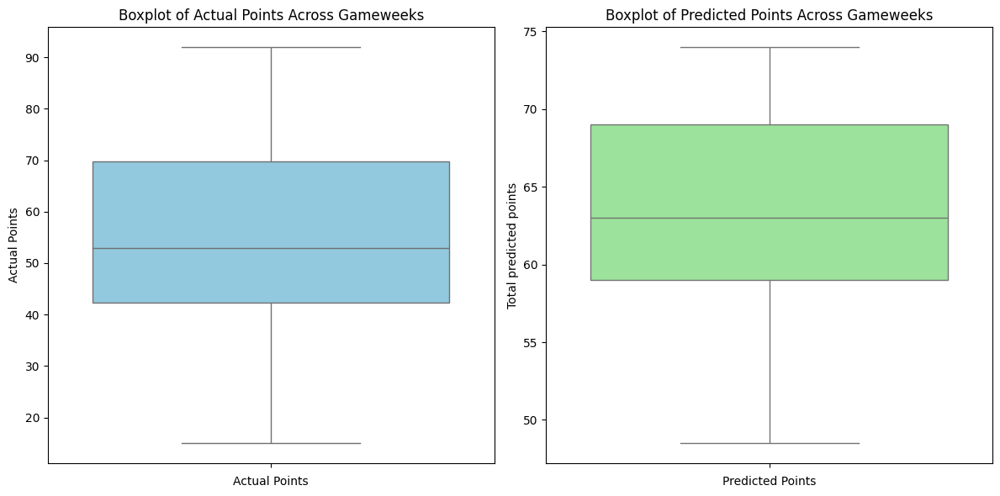

In [48]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data (replace with your actual file path)
df_1_38_m1 = df_1_38_p_a
df = df_1_38_m1

# Create a figure with two subplots side by side
plt.figure(figsize=(12, 6))

# First boxplot: Actual Points
plt.subplot(1, 2, 1)  # 1 row, 2 columns, 1st subplot
sns.boxplot(y=df['Actual Points'], color='skyblue')  # Boxplot for Actual Points
plt.title('Boxplot of Actual Points Across Gameweeks')
plt.xlabel('Actual Points')

# Second boxplot: Predicted Points
plt.subplot(1, 2, 2)  # 1 row, 2 columns, 2nd subplot
sns.boxplot(y=df['Total predicted points'], color='lightgreen')  # Boxplot for Predicted Points
plt.title('Boxplot of Predicted Points Across Gameweeks')
plt.xlabel('Predicted Points')

# Show the plots
plt.tight_layout()  # Adjust layout to avoid overlap
plt.show()

#### Linegraph

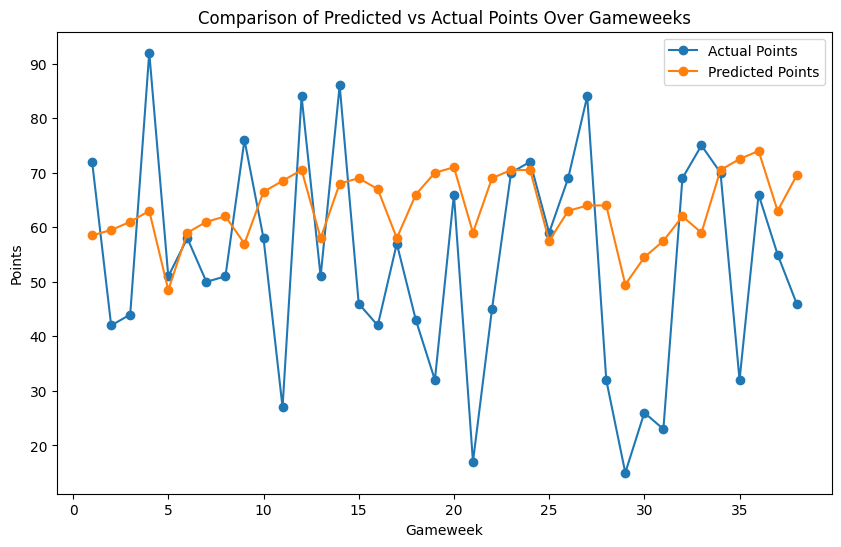

In [49]:
# Plot
plt.figure(figsize=(10, 6))

# Plotting both actual and predicted points on the same graph
plt.plot(df['Gameweek'], df['Actual Points'], label='Actual Points', marker='o')
plt.plot(df['Gameweek'], df['Total predicted points'], label='Predicted Points', marker='o')

# Adding titles and labels
plt.title('Comparison of Predicted vs Actual Points Over Gameweeks')
plt.xlabel('Gameweek')
plt.ylabel('Points')

# Show the legend
plt.legend()

# Show the plot
plt.show()